<a href="https://colab.research.google.com/github/srikantharun/geospatial-processor-system/blob/main/sel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TamilNadu Remote Sensing Analysis for Solar Potential
# This notebook analyzes Sentinel-2 imagery for Tamil Nadu cities to assess solar energy potential

In [4]:
!pip install -q matplotlib numpy pandas geopandas rioxarray xarray pystac-client folium planetary-computer stackstac odc-stac dask distributed hvplot datashader cachey pyproj ipyleaflet scikit-learn geemap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.2/62.2 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.4/41.4 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.3/64.3 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.4/89.4 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.9/161.9 kB 16.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 71.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.1/155.1 kB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 206.8/206.8 kB 20.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 97.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 83.4 MB/s eta 0:00:00


In [5]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import rioxarray as rxr
import xarray as xr
import folium
import pystac_client
from shapely.geometry import mapping, box, Polygon
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')
from dask.distributed import Client, progress
import geemap

# Set up a Dask client for distributed computing

In [6]:
client = Client(n_workers=4, threads_per_worker=2, memory_limit='2GB')
print(f"Dask dashboard available at: {client.dashboard_link}")

INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:35581
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:8787/status
INFO:distributed.scheduler:Registering Worker plugin shuffle
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:42345'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34525'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:39533'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:40667'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:46723 name: 0
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:46723
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:54184
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:45273 name: 2
INFO:

Dask dashboard available at: http://127.0.0.1:8787/status


# Create directories for data and output

In [7]:
data_folder = 'data'
output_folder = 'output'

if not os.path.exists(data_folder):
    os.makedirs(data_folder)
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Function to download data

In [8]:
def download(url, filename=None):
    import requests
    if filename is None:
        filename = os.path.join(data_folder, os.path.basename(url))
    else:
        filename = os.path.join(data_folder, filename)

    if not os.path.exists(filename):
        response = requests.get(url)
        with open(filename, 'wb') as f:
            f.write(response.content)
        print(f'Downloaded {filename}')
    return filename

# Define Tamil Nadu cities of interest with their coordinates

In [9]:
tamilnadu_cities = {
    'Chennai': {'lat': 13.0827, 'lon': 80.2707, 'buffer_km': 30},
    'Madurai': {'lat': 9.9252, 'lon': 78.1198, 'buffer_km': 20},
    'Hosur': {'lat': 12.7409, 'lon': 77.8253, 'buffer_km': 15},
    'Tuticorin': {'lat': 8.7642, 'lon': 78.1348, 'buffer_km': 20}
}

# Create GeoJSON for each city with a buffer around the center

In [10]:
def create_city_aoi(city_name, lat, lon, buffer_km):
    # Convert buffer from km to degrees (approximate)
    buffer_deg = buffer_km / 111  # ~111 km per degree

    # Create a simple box around the city center
    min_lon = lon - buffer_deg
    max_lon = lon + buffer_deg
    min_lat = lat - buffer_deg
    max_lat = lat + buffer_deg

    # Create polygon
    polygon = box(min_lon, min_lat, max_lon, max_lat)

    # Create GeoDataFrame
    gdf = gpd.GeoDataFrame(
        {'city': [city_name]},
        geometry=[polygon],
        crs="EPSG:4326"
    )

    # Save as GeoJSON
    output_file = os.path.join(data_folder, f"{city_name.lower()}.geojson")
    gdf.to_file(output_file, driver="GeoJSON")

    return gdf, output_file

# Create AOI GeoJSONs for each city
city_gdfs = {}
city_files = {}
for city, info in tamilnadu_cities.items():
    city_gdfs[city], city_files[city] = create_city_aoi(
        city, info['lat'], info['lon'], info['buffer_km']
    )
    print(f"Created AOI for {city}")

# Display the cities on a map
m = folium.Map(location=[11.1271, 78.6569], zoom_start=7)  # Center of Tamil Nadu

for city, gdf in city_gdfs.items():
    folium.GeoJson(
        gdf,
        name=city,
        style_function=lambda x, city=city: {
            'fillColor': '#0000ff',
            'color': '#0000ff',
            'weight': 2,
            'fillOpacity': 0.2
        }
    ).add_to(m)

    # Add city marker
    folium.Marker(
        [tamilnadu_cities[city]['lat'], tamilnadu_cities[city]['lon']],
        popup=city
    ).add_to(m)

# Display the map
m

Created AOI for Chennai
Created AOI for Madurai
Created AOI for Hosur
Created AOI for Tuticorin


# Function to retrieve Sentinel-2 imagery using STAC API

In [11]:
def get_sentinel_imagery(geometry, time_range, cloud_cover_limit=30, catalog_url="https://earth-search.aws.element84.com/v1"):
    """
    Retrieve Sentinel-2 imagery for a given geometry and time range

    Parameters:
    -----------
    geometry : dict or shapely.geometry
        AOI geometry
    time_range : str
        Time range in format 'YYYY-MM'
    cloud_cover_limit : int
        Maximum cloud cover percentage
    catalog_url : str
        STAC catalog URL

    Returns:
    --------
    items : list
        List of STAC items
    """
    # Connect to the STAC API
    catalog = pystac_client.Client.open(catalog_url)

    cloud_cover_limit=70

    # Set up the search parameters
    filters = {
        'eo:cloud_cover': {'lt': cloud_cover_limit}
    }

    # Search for items
    search = catalog.search(
        collections=['sentinel-2-c1-l2a'],
        intersects=geometry,
        datetime=time_range,
        query=filters
    )

    # Get the items
    items = search.item_collection()

    return items

# Function to create a cloud-free composite

In [37]:
def create_composite(items, bands, aoi_geometry, resolution=10):
    """
    Create a cloud-free composite from Sentinel-2 imagery

    Parameters:
    -----------
    items : list
        List of STAC items
    bands : list
        List of bands to include
    aoi_geometry : dict or shapely.geometry
        AOI geometry
    resolution : int
        Output resolution in meters

    Returns:
    --------
    composite : xarray.DataArray
        Cloud-free composite
    """
    from odc.stac import stac_load

    if len(items) == 0:
        print("No items found")
        return None

    bands=['red', 'green', 'blue', 'nir', 'B08']

    # Load the data
    ds = stac_load(
        items,
        bands=bands + ['scl'],  # Add SCL band for cloud masking
        resolution=resolution,
        bbox=aoi_geometry.bounds,
        chunks={},  # Use Dask
        groupby='solar_day',
    )

    # Convert to array
    da = ds.to_array('band')

    # Get SCL band for cloud masking
    scl = da.sel(band='scl')

    # Mask clouds using SCL band
    # SCL values 0,1,2,3,8,9,10 are clouds or invalid
    # SCL values 4,5,6,7,11 are valid (vegetation, bare, water, snow)
    valid = ((scl == 4) | (scl == 5) | (scl == 6) | (scl == 7) | (scl == 11))

    # Apply mask
    da_masked = da.where(valid)

    # Create median composite
    composite = da_masked.sel(band=bands).median(dim='time')

    return composite

# Function to calculate NDVI

In [38]:
def calculate_ndvi(red, nir):
    """
    Calculate NDVI from red and near-infrared bands

    Parameters:
    -----------
    red : xarray.DataArray
        Red band
    nir : xarray.DataArray
        Near-infrared band

    Returns:
    --------
    ndvi : xarray.DataArray
        NDVI
    """
    ndvi = (nir - red) / (nir + red)
    return ndvi

# Function to calculate NDWI (for water detection)

In [39]:
def calculate_ndwi(green, nir):
    """
    Calculate NDWI from green and near-infrared bands

    Parameters:
    -----------
    green : xarray.DataArray
        Green band
    nir : xarray.DataArray
        Near-infrared band

    Returns:
    --------
    ndwi : xarray.DataArray
        NDWI
    """
    ndwi = (green - nir) / (green + nir)
    return ndwi

# Function to calculate BSI (Bare Soil Index)

In [40]:
def calculate_bsi(blue, red, nir, swir):
    """
    Calculate BSI from blue, red, near-infrared, and short-wave infrared bands

    Parameters:
    -----------
    blue : xarray.DataArray
        Blue band
    red : xarray.DataArray
        Red band
    nir : xarray.DataArray
        Near-infrared band
    swir : xarray.DataArray
        Short-wave infrared band

    Returns:
    --------
    bsi : xarray.DataArray
        BSI
    """
    bsi = ((swir + red) - (nir + blue)) / ((swir + red) + (nir + blue))
    return bsi

# Function to calculate built-up area index

In [41]:
def calculate_built_up(red, green, nir, swir):
    """
    Calculate built-up area index

    Parameters:
    -----------
    red : xarray.DataArray
        Red band
    green : xarray.DataArray
        Green band
    nir : xarray.DataArray
        Near-infrared band
    swir : xarray.DataArray
        Short-wave infrared band

    Returns:
    --------
    built_up : xarray.DataArray
        Built-up area index
    """
    # Modified Normalized Difference Built-up Index (MNDBI)
    mndbi = (swir - nir) / (swir + nir)
    return mndbi

# Function to analyze cloud cover from Sentinel-2 imagery

In [42]:
def analyze_cloud_cover(items, aoi_geometry, resolution=10):
    """
    Analyze cloud cover from Sentinel-2 imagery

    Parameters:
    -----------
    items : list
        List of STAC items
    aoi_geometry : dict or shapely.geometry
        AOI geometry
    resolution : int
        Output resolution in meters

    Returns:
    --------
    cloud_cover : pandas.DataFrame
        Cloud cover percentages for each date
    """
    from odc.stac import stac_load

    if len(items) == 0:
        print("No items found")
        return None

    # Load the SCL band
    ds = stac_load(
        items,
        bands=['scl'],
        resolution=resolution,
        bbox=aoi_geometry.bounds,
        chunks={},  # Use Dask
        groupby='solar_day',
    )

    # Calculate cloud cover percentage for each date
    cloud_cover = []

    for date in ds.time.values:
        # Get SCL band for this date
        scl = ds.sel(time=date).scl

        # Count total pixels
        total_pixels = scl.count().compute().item()

        if total_pixels == 0:
            continue

        # Count cloud pixels (SCL values 1, 2, 3, 8, 9, 10)
        cloud_pixels = ((scl == 1) | (scl == 2) | (scl == 3) |
                         (scl == 8) | (scl == 9) | (scl == 10)).sum().compute().item()

        # Calculate cloud cover percentage
        cloud_pct = (cloud_pixels / total_pixels) * 100

        cloud_cover.append({
            'date': pd.to_datetime(date).strftime('%Y-%m-%d'),
            'cloud_cover_pct': cloud_pct
        })

    return pd.DataFrame(cloud_cover)

# Function to classify land use

In [43]:
def classify_land_use(composite, threshold_values=None):
    """
    Classify land use from Sentinel-2 composite

    Parameters:
    -----------
    composite : xarray.DataArray
        Sentinel-2 composite with all required bands
    threshold_values : dict
        Dictionary of threshold values for classification

    Returns:
    --------
    land_use : xarray.DataArray
        Land use classification
    """
    if threshold_values is None:
        threshold_values = {
            'ndvi_veg': 0.4,      # NDVI threshold for vegetation
            'ndwi_water': 0.3,    # NDWI threshold for water
            'built_up': 0.0,      # Built-up threshold
            'bare_soil': 0.0      # Bare soil threshold
        }

    # Extract bands
    red = composite.sel(band='red')
    green = composite.sel(band='green')
    blue = composite.sel(band='blue')
    nir = composite.sel(band='nir')
    swir = composite.sel(band='swir1') if 'swir1' in composite.band.values else composite.sel(band='swir')

    # Calculate indices
    ndvi = calculate_ndvi(red, nir)
    ndwi = calculate_ndwi(green, nir)
    built_up = calculate_built_up(red, green, nir, swir)
    bsi = calculate_bsi(blue, red, nir, swir)

    # Create land use classification
    # 1: Vegetation, 2: Water, 3: Built-up, 4: Bare soil, 0: Other
    land_use = xr.zeros_like(red)

    # Vegetation (high NDVI)
    land_use = land_use.where(ndvi <= threshold_values['ndvi_veg'], 1)

    # Water (high NDWI)
    land_use = land_use.where(ndwi <= threshold_values['ndwi_water'], 2)

    # Built-up (high built-up index)
    land_use = land_use.where(built_up <= threshold_values['built_up'], 3)

    # Bare soil (high BSI)
    land_use = land_use.where(bsi <= threshold_values['bare_soil'], 4)

    return land_use


# Function to calculate solar potential

In [44]:
def calculate_solar_potential(composite, cloud_cover_df, land_use_classification):
    """
    Calculate solar potential from Sentinel-2 composite, cloud cover, and land use

    Parameters:
    -----------
    composite : xarray.DataArray
        Sentinel-2 composite
    cloud_cover_df : pandas.DataFrame
        Cloud cover data
    land_use_classification : xarray.DataArray
        Land use classification

    Returns:
    --------
    solar_potential : xarray.DataArray
        Solar potential map
    """
    # Start with maximum potential (100%)
    solar_potential = xr.ones_like(composite.sel(band='red')) * 100

    # Factors that affect solar potential:
    # 1. Cloud cover - average from the dataframe
    avg_cloud_cover = cloud_cover_df['cloud_cover_pct'].mean()
    cloud_reduction = avg_cloud_cover * 0.5  # 50% reduction for each percent of cloud cover

    # Apply cloud cover reduction
    solar_potential = solar_potential - cloud_reduction

    # 2. Land use - different reductions based on land use type
    # Vegetation: -10%, Water: -5%, Built-up: -20%, Bare soil: -5%
    land_use_reduction = xr.zeros_like(solar_potential)
    land_use_reduction = land_use_reduction.where(land_use_classification != 1, 10)  # Vegetation
    land_use_reduction = land_use_reduction.where(land_use_classification != 2, 5)   # Water
    land_use_reduction = land_use_reduction.where(land_use_classification != 3, 20)  # Built-up
    land_use_reduction = land_use_reduction.where(land_use_classification != 4, 5)   # Bare soil

    # Apply land use reduction
    solar_potential = solar_potential - land_use_reduction

    # Ensure values are within range [0, 100]
    solar_potential = solar_potential.clip(0, 100)

    return solar_potential

# Function to perform a complete analysis for a city

In [45]:
def analyze_city(city_name, time_periods, bands=['red', 'green', 'blue', 'B08']):
    import xarray as xr
    """
    Perform complete analysis for a city

    Parameters:
    -----------
    city_name : str
        Name of the city
    time_periods : list
        List of time periods to analyze (format: 'YYYY-MM')
    bands : list
        List of bands to include

    Returns:
    --------
    results : dict
        Dictionary of results
    """
    results = {
        'city': city_name,
        'time_periods': {},
    }

    # Get city geometry
    city_gdf = city_gdfs[city_name]
    city_geometry = city_gdf.geometry.iloc[0]

    for period in time_periods:
        print(f"Analyzing {city_name} for period {period}...")

        # Get Sentinel-2 imagery
        items = get_sentinel_imagery(mapping(city_geometry), period)
        print(f"Found {len(items)} Sentinel-2 scenes")

        if len(items) == 0:
            print(f"No data available for {city_name} in {period}")
            continue

        try:
            # Create composite - modified to check for available bands first
            from odc.stac import stac_load

            # First check which bands are available in this collection
            sample_item = items[0]
            available_bands = list(sample_item.assets.keys())

            # Filter bands to those actually available (common band naming issues)
            actual_bands = []
            band_mapping = {
                'red': ['red', 'B04'],
                'green': ['green', 'B03'],
                'blue': ['blue', 'B02'],
                'nir': ['nir', 'B08', 'B8', 'B8A'],
                'swir1': ['swir1', 'swir', 'B11', 'B12']
            }

            request_bands = []
            for band in bands:
                possible_names = band_mapping.get(band, [band])
                found = False
                for name in possible_names:
                    if name in available_bands:
                        request_bands.append(name)
                        found = True
                        break
                if not found:
                    print(f"Warning: Could not find band {band} in available bands: {available_bands}")

            if not request_bands:
                print(f"Error: No usable bands found for {city_name} in {period}")
                continue

            print(f"Using bands: {request_bands}")

            # Add SCL band for cloud masking if available
            if 'scl' in available_bands:
                request_bands.append('scl')

            # Load the data with available bands
            ds = stac_load(
                items,
                bands=request_bands,
                resolution=10,
                bbox=city_geometry.bounds,
                chunks={},  # Use Dask
                groupby='solar_day',
            )

            # Convert to array
            da = ds.to_array('band')

            # Cloud masking - handle the case where SCL band might not be available
            if 'scl' in request_bands:
                scl = da.sel(band='scl')
                valid = ((scl == 4) | (scl == 5) | (scl == 6) | (scl == 7) | (scl == 11))
                da_masked = da.where(valid)
            else:
                # Simple cloud masking using band thresholds if SCL not available
                # This is a basic approach, can be improved
                print("SCL band not available, using simple cloud detection")
                if 'red' in request_bands and 'blue' in request_bands:
                    blue = da.sel(band='blue') if 'blue' in request_bands else da.sel(band='B02')
                    red = da.sel(band='red') if 'red' in request_bands else da.sel(band='B04')
                    # Simple cloud detection (high reflectance in visible bands)
                    valid = (blue < 3000) & (red < 3000)
                    da_masked = da.where(valid)
                else:
                    # If we don't have enough bands for cloud detection, use original data
                    da_masked = da

            # Create RGB composite
            rgb_bands = []
            if 'red' in request_bands or 'B04' in request_bands:
                rgb_bands.append('red' if 'red' in request_bands else 'B04')
            if 'green' in request_bands or 'B03' in request_bands:
                rgb_bands.append('green' if 'green' in request_bands else 'B03')
            if 'blue' in request_bands or 'B02' in request_bands:
                rgb_bands.append('blue' if 'blue' in request_bands else 'B02')

            if len(rgb_bands) == 3:
                composite = da_masked.sel(band=rgb_bands).median(dim='time')
            else:
                print(f"Warning: Could not create RGB composite, missing bands. Using available bands.")
                composite = da_masked.median(dim='time')

            try:
                # Break computation into smaller chunks
                print("Computing composite image...")

                # First persist to start computation but keep the task graph
                composite = composite.persist()

                # Add a wait with a progress bar
                from dask.distributed import progress
                progress(composite)

                # Now finalize computation
                composite = composite.compute(retries=3)  # Add retries for resilience
                print("Composite computation successful")
            except Exception as e:
                print(f"Error computing composite: {e}")
                print("Trying alternative approach with smaller chunks...")

                try:
                    # Try computing band by band
                    band_arrays = []
                    for b in composite.band.values:
                        print(f"Computing band {b}...")
                        band_data = composite.sel(band=b).compute(retries=3)
                        band_arrays.append(band_data)

                    # Reconstruct the composite
                    import xarray as xr
                    composite = xr.concat(band_arrays, dim='band')
                    print("Alternative computation successful")
                except Exception as e2:
                    print(f"Alternative approach also failed: {e2}")
                    print("Skipping this time period due to computation errors")
                    continue  # Skip to next time period

            # Compute composite (execute Dask computation)
            composite = composite.compute()

            # Analyze cloud cover
            cloud_cover = analyze_cloud_cover(items, city_geometry)

            # Create a simple land use classification based on available bands
            # Adapted to work with whatever bands we have
            if len(rgb_bands) == 3:
                # Use a simpler approach for land use classification that works with RGB only
                land_use = xr.zeros_like(composite.isel(band=0))

                # Extract RGB bands
                red_idx = rgb_bands.index('red' if 'red' in rgb_bands else 'B04')
                green_idx = rgb_bands.index('green' if 'green' in rgb_bands else 'B03')
                blue_idx = rgb_bands.index('blue' if 'blue' in rgb_bands else 'B02')

                red = composite.isel(band=red_idx)
                green = composite.isel(band=green_idx)
                blue = composite.isel(band=blue_idx)

                # Simple RGB-based classification
                # 1: Vegetation (high green)
                # 2: Water (high blue, low others)
                # 3: Built-up (high red and green, low blue)
                # 4: Bare soil (high red, low others)
                # 0: Other

                # Normalize bands for comparison
                red_norm = red / 3000
                green_norm = green / 3000
                blue_norm = blue / 3000

                # Vegetation (high green relative to red and blue)
                veg_mask = (green_norm > 1.2 * red_norm) & (green_norm > 1.2 * blue_norm)
                land_use = land_use.where(~veg_mask, 1)

                # Water (high blue relative to others and low overall reflectance)
                water_mask = (blue_norm > 1.2 * red_norm) & (blue_norm > green_norm) & (blue < 1000)
                land_use = land_use.where(~water_mask, 2)

                # Built-up (high overall reflectance, especially red)
                built_mask = (red > 1500) & (green > 1200) & (blue > 1000)
                land_use = land_use.where(~built_mask, 3)

                # Bare soil (high red relative to others)
                soil_mask = (red_norm > 1.3 * green_norm) & (red_norm > 1.5 * blue_norm)
                land_use = land_use.where(~soil_mask, 4)
            else:
                # If we don't have RGB, create a placeholder land use classification
                land_use = xr.zeros_like(composite.isel(band=0))

            # Calculate solar potential based on cloud cover
            # Simplified approach that doesn't require specific indices
            avg_cloud_cover = cloud_cover['cloud_cover_pct'].mean() if not cloud_cover.empty else 50

            # Base solar potential on cloud cover
            solar_potential = xr.ones_like(land_use) * (100 - avg_cloud_cover * 0.5)

            # Adjust based on simple land use if available
            if not land_use.equals(xr.zeros_like(land_use)):
                # Different reductions based on land use
                solar_potential = solar_potential.where(land_use != 1, solar_potential - 10)  # Vegetation: -10%
                solar_potential = solar_potential.where(land_use != 2, solar_potential - 5)   # Water: -5%
                solar_potential = solar_potential.where(land_use != 3, solar_potential - 20)  # Built-up: -20%
                solar_potential = solar_potential.where(land_use != 4, solar_potential - 5)   # Bare soil: -5%

            # Ensure values are within range [0, 100]
            solar_potential = solar_potential.clip(0, 100)

            # Store results
            results['time_periods'][period] = {
                'composite': composite,
                'cloud_cover': cloud_cover,
                'land_use': land_use,
                'solar_potential': solar_potential
            }

            # Save results
            composite_file = os.path.join(output_folder, f"{city_name.lower()}_{period.replace('-', '_')}_composite.tif")
            solar_file = os.path.join(output_folder, f"{city_name.lower()}_{period.replace('-', '_')}_solar_potential.tif")

            # Save composite as GeoTIFF
            composite = composite.transpose('band', 'y', 'x')  # Rearrange dimensions for rioxarray
            composite.rio.to_raster(composite_file)
            print(f"Saved composite to {composite_file}")

            # Save solar potential as GeoTIFF
            solar_potential.rio.to_raster(solar_file)
            print(f"Saved solar potential to {solar_file}")

        except Exception as e:
            print(f"Error processing {city_name} for period {period}: {e}")
            import traceback
            traceback.print_exc()

    return results

# Perform analysis for each city

In [46]:
# Time periods to analyze (seasonal)
time_periods = [
    '2024-02',  # Winter
    '2024-05',  # Summer
    '2023-09',  # Monsoon
    '2023-12'   # Post-monsoon
]

# Create a more robust client with timeouts and retries
client = Client(
    n_workers=2,  # Fewer workers to avoid memory issues
    threads_per_worker=1,
    memory_limit='4GB',
    timeout='5 minutes',  # Longer timeouts
    dashboard_address=':8787'  # For monitoring
)

# Configure adaptive scaling if in cloud environment
from dask.distributed import Adaptive
adaptive = Adaptive(client.cluster, minimum=2, maximum=4)

# Set up work stealing for better load balancing
client.cluster.scheduler.work_stealing = True

# Perform analysis for each city
city_results = {}
for city in tamilnadu_cities.keys():
    city_results[city] = analyze_city(city, time_periods)

# Function to visualize results
def visualize_results(results, city_name, time_period):
    """
    Visualize results for a city and time period

    Parameters:
    -----------
    results : dict
        Results dictionary
    city_name : str
        Name of the city
    time_period : str
        Time period to visualize
    """
    if time_period not in results[city_name]['time_periods']:
        print(f"No results available for {city_name} in {time_period}")
        return

    city_result = results[city_name]['time_periods'][time_period]

    # Create figure
    fig, axs = plt.subplots(2, 2, figsize=(16, 12))

    # Plot RGB composite
    rgb = city_result['composite'].sel(band=['red', 'green', 'blue'])
    rgb = rgb / rgb.quantile(0.95)  # Scale for better visualization
    rgb = rgb.clip(0, 1)
    rgb.plot.imshow(ax=axs[0, 0], rgb='band')
    axs[0, 0].set_title(f"{city_name} - {time_period} - RGB Composite")
    axs[0, 0].axis('off')

    # Plot land use classification
    land_use = city_result['land_use']
    land_use.plot(ax=axs[0, 1], cmap='viridis', add_colorbar=True)
    axs[0, 1].set_title(f"{city_name} - {time_period} - Land Use Classification")
    axs[0, 1].axis('off')

    # Plot cloud cover time series
    cloud_df = city_result['cloud_cover']
    cloud_df.plot(x='date', y='cloud_cover_pct', ax=axs[1, 0], kind='bar')
    axs[1, 0].set_title(f"{city_name} - {time_period} - Cloud Cover")
    axs[1, 0].set_ylabel("Cloud Cover (%)")
    axs[1, 0].set_xlabel("Date")
    axs[1, 0].tick_params(axis='x', rotation=45)

    # Plot solar potential
    solar = city_result['solar_potential']
    solar.plot(ax=axs[1, 1], cmap='YlOrRd', vmin=0, vmax=100, add_colorbar=True)
    axs[1, 1].set_title(f"{city_name} - {time_period} - Solar Potential")
    axs[1, 1].axis('off')

    plt.tight_layout()
    plt.savefig(os.path.join(output_folder, f"{city_name.lower()}_{time_period.replace('-', '_')}_results.png"))
    plt.show()

INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:35715
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:43873/status
INFO:distributed.scheduler:Registering Worker plugin shuffle
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:41197'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:42885'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:38287 name: 0
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:38287
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35934
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:45819 name: 1
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:45819
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35920
INFO:distributed.scheduler:Receive client connection: Client-45fa79ac-2203-11f0-87cc-0242ac1c000c
INFO:distributed.core:Starting establis

Analyzing Chennai for period 2024-02...
Found 12 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:41767'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:37443'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:33995 name: 3
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:33995
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35032
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:36161 name: 2
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:36161
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35040
INFO:distributed.deploy.adaptive:Retiring workers [1, 3]
INFO:distributed.scheduler:Retire worker names (1, 3)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:33995; 11 keys are being moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:45819; 15 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [3]
INFO:distributed.scheduler:Retire worker names (3,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:38993; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:38993 name: 3 (stimulus_id='retire-workers-1745605905.3596852')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:38993' (stimulus_id='retire-workers-1745605905.3596852')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745605905.3647113') (3,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:34561'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Connection to tcp://127.0.0.1:46432 has been closed.
INFO:distributed.nanny:Worker process 16825 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:34561' closed.
INFO:distributed.deploy.adaptive:Retiring workers [4]
INFO:distri

Saved composite to output/chennai_2024_02_composite.tif
Saved solar potential to output/chennai_2024_02_solar_potential.tif
Analyzing Chennai for period 2024-05...
Found 6 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:45459'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35737'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:35483 name: 4
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:35483
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:54426
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:38781 name: 5
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:38781
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:54418
INFO:distributed.deploy.adaptive:Retiring workers [5]
INFO:distributed.scheduler:Retire worker names (5,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:38781; 5 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:38781 name: 5 (stimulus_id='retire-workers-1745605985.3612707')
INFO:distributed.scheduler:Retired worke

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [0]
INFO:distributed.scheduler:Retire worker names (0,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:38287; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:38287 name: 0 (stimulus_id='retire-workers-1745605998.3599799')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:38287' (stimulus_id='retire-workers-1745605998.3599799')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745605998.365653') (0,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:41197'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Connection to tcp://127.0.0.1:35934 has been closed.
INFO:distributed.nanny:Worker process 16310 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:41197' closed.


Saved composite to output/chennai_2024_05_composite.tif
Saved solar potential to output/chennai_2024_05_solar_potential.tif
Analyzing Chennai for period 2023-09...
Found 11 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34223'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35767'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:41467 name: 6
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:41467
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:44486
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:43491 name: 5
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:43491
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:44492


Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [6]
INFO:distributed.scheduler:Retire worker names (6,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:41467; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:41467 name: 6 (stimulus_id='retire-workers-1745606094.3597777')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:41467' (stimulus_id='retire-workers-1745606094.3597777')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606094.3648448') (6,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:35767'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Received 'close-stream' from tcp://127.0.0.1:44486; closing.
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:35767' closed.
INFO:distributed.deploy.adaptive:Retiring workers [2]
INFO:distributed.scheduler:Retire worker names (2,)
INFO:distributed.a

Saved composite to output/chennai_2023_09_composite.tif
Saved solar potential to output/chennai_2023_09_solar_potential.tif
Analyzing Chennai for period 2023-12...
Found 7 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34433'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:42907'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:44561 name: 6
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:44561
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:59780
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:44529 name: 7
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:44529
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:59788
INFO:distributed.deploy.adaptive:Retiring workers [6]
INFO:distributed.scheduler:Retire worker names (6,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:44561; 8 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:44561 name: 6 (stimulus_id='retire-workers-1745606183.3600178')
INFO:distributed.scheduler:Retired worke

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [5]
INFO:distributed.scheduler:Retire worker names (5,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:43491; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:43491 name: 5 (stimulus_id='retire-workers-1745606188.3597639')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:43491' (stimulus_id='retire-workers-1745606188.3597639')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606188.3651927') (5,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:34223'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Connection to tcp://127.0.0.1:44492 has been closed.
INFO:distributed.nanny:Worker process 17367 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:34223' closed.


Saved composite to output/chennai_2023_12_composite.tif
Saved solar potential to output/chennai_2023_12_solar_potential.tif
Analyzing Madurai for period 2024-02...
Found 22 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:33305'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:39093'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:37923 name: 9
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:37923
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48952
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:37773 name: 8
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:37773
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48954


Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [9, 7]
INFO:distributed.scheduler:Retire worker names (9, 7)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:37923; no unique keys need to be moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:44529; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:37923 name: 9 (stimulus_id='retire-workers-1745606277.3596377')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:37923' (stimulus_id='retire-workers-1745606277.3596377')
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:44529 name: 7 (stimulus_id='retire-workers-1745606277.3596377')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:44529' (stimulus_id='retire-workers-1745606277.3596377')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606277.3669167') (9, 7)
INFO:distributed.nanny:Closing Nanny gracefully at 'tcp://127.0

Saved composite to output/madurai_2024_02_composite.tif
Saved solar potential to output/madurai_2024_02_solar_potential.tif
Analyzing Madurai for period 2024-05...
Found 6 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35351'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:44281'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:33647 name: 9
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:33647
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:55980
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:39483 name: 10
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:39483
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:55986
INFO:distributed.deploy.adaptive:Retiring workers [8, 4]
INFO:distributed.scheduler:Retire worker names (8, 4)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:37773; 2 keys are being moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:35483; 1 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://1

Composite computation successful
Saved composite to output/madurai_2024_05_composite.tif
Saved solar potential to output/madurai_2024_05_solar_potential.tif
Analyzing Madurai for period 2023-09...
Found 13 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35691'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:46467'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:34589 name: 12
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:34589
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:43722
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:43879 name: 11
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:43879
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:43736
INFO:distributed.deploy.adaptive:Retiring workers [10, 12]
INFO:distributed.scheduler:Retire worker names (10, 12)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:34589; 6 keys are being moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:39483; 2 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tc

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [12]
INFO:distributed.scheduler:Retire worker names (12,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:44937; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:44937 name: 12 (stimulus_id='retire-workers-1745606392.361074')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:44937' (stimulus_id='retire-workers-1745606392.361074')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606392.3666556') (12,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:34937'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Connection to tcp://127.0.0.1:54458 has been closed.
INFO:distributed.nanny:Worker process 19038 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:34937' closed.


Saved composite to output/madurai_2023_09_composite.tif
Saved solar potential to output/madurai_2023_09_solar_potential.tif
Analyzing Madurai for period 2023-12...
Found 9 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:40871'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:45471'


Computing composite image...


INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:34809 name: 13
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:34809
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46656
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:36467 name: 12
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:36467
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46672
INFO:distributed.deploy.adaptive:Retiring workers [9, 13]
INFO:distributed.scheduler:Retire worker names (9, 13)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:33647; 5 keys are being moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:34809; 1 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:34809 name: 13 (stimulus_id='retire-workers-1745606448.3596463')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:34809'

Composite computation successful
Saved composite to output/madurai_2023_12_composite.tif
Saved solar potential to output/madurai_2023_12_solar_potential.tif
Analyzing Hosur for period 2024-02...
Found 24 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:39637'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:38935 name: 13
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:38935
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:33202
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:38973'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:37181 name: 14
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:37181
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:33244
INFO:distributed.deploy.adaptive:Retiring workers [11, 14]
INFO:distributed.scheduler:Retire worker names (11, 14)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:43879; 12 keys are being moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:37181; 5 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: t

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [14]
INFO:distributed.scheduler:Retire worker names (14,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:42979; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:42979 name: 14 (stimulus_id='retire-workers-1745606523.3601131')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:42979' (stimulus_id='retire-workers-1745606523.3601131')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606523.3655744') (14,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:42347'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Received 'close-stream' from tcp://127.0.0.1:47300; closing.
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:42347' closed.
INFO:distributed.deploy.adaptive:Retiring workers [13]
INFO:distributed.scheduler:Retire worker names (13,)
INFO:distrib

Saved composite to output/hosur_2024_02_composite.tif
Saved solar potential to output/hosur_2024_02_solar_potential.tif
Analyzing Hosur for period 2024-05...
Found 13 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:36503'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:38215 name: 16
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:38215
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:32916
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:39161'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:42157 name: 17
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:42157
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:32946
INFO:distributed.deploy.adaptive:Retiring workers [17]
INFO:distributed.scheduler:Retire worker names (17,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:42157; 7 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:42157 name: 17 (stimulus_id='retire-workers-1745606575.3595355')
INFO:distributed.scheduler:Retired 

Composite computation successful
Saved composite to output/hosur_2024_05_composite.tif
Saved solar potential to output/hosur_2024_05_solar_potential.tif
Analyzing Hosur for period 2023-09...
Found 3 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:41023'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:38981'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:46715 name: 17
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:46715
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:55460
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:35505 name: 18
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:35505
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:55444
INFO:distributed.deploy.adaptive:Retiring workers [15]
INFO:distributed.scheduler:Retire worker names (15,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:38589; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:38589 name: 15 (stimulus_id='retire-workers-1745606606.3603687')
INFO:distributed.scheduler

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [16]
INFO:distributed.scheduler:Retire worker names (16,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:38215; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:38215 name: 16 (stimulus_id='retire-workers-1745606618.3602018')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:38215' (stimulus_id='retire-workers-1745606618.3602018')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606618.3661022') (16,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:36503'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close


Saved composite to output/hosur_2023_09_composite.tif
Saved solar potential to output/hosur_2023_09_solar_potential.tif
Analyzing Hosur for period 2023-12...


INFO:distributed.core:Connection to tcp://127.0.0.1:32916 has been closed.
INFO:distributed.nanny:Worker process 19821 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:36503' closed.


Found 11 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:37957'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:36135'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:43463 name: 20
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:43463
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:52270
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:35391 name: 19
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:35391
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:52272
INFO:distributed.deploy.adaptive:Retiring workers [20]
INFO:distributed.scheduler:Retire worker names (20,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:43463; 1 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:43463 name: 20 (stimulus_id='retire-workers-1745606647.3603787')
INFO:distributed.scheduler:Retired 

Composite computation successful
Saved composite to output/hosur_2023_12_composite.tif
Saved solar potential to output/hosur_2023_12_solar_potential.tif
Analyzing Tuticorin for period 2024-02...
Found 13 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35073'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:36127 name: 20
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:36127
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:44638
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:37817'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:39501 name: 21
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:39501
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:44646
INFO:distributed.deploy.adaptive:Retiring workers [20, 21]
INFO:distributed.scheduler:Retire worker names (20, 21)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:39501; 9 keys are being moved away.
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:36127; 2 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tc

Composite computation successful
Saved composite to output/tuticorin_2024_02_composite.tif
Saved solar potential to output/tuticorin_2024_02_solar_potential.tif
Analyzing Tuticorin for period 2024-05...
Found 3 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:36867'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:45055'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:40645 name: 21
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:40645
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:40290
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:44231 name: 22
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:44231
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:40306
INFO:distributed.deploy.adaptive:Retiring workers [21]
INFO:distributed.scheduler:Retire worker names (21,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:40645; 1 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:40645 name: 21 (stimulus_id='retire-workers-1745606752.3593354')
INFO:distributed.scheduler:Retired 

Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [17]
INFO:distributed.scheduler:Retire worker names (17,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:46715; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:46715 name: 17 (stimulus_id='retire-workers-1745606768.3601813')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:46715' (stimulus_id='retire-workers-1745606768.3601813')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606768.3645852') (17,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:41023'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close


Saved composite to output/tuticorin_2024_05_composite.tif
Saved solar potential to output/tuticorin_2024_05_solar_potential.tif
Analyzing Tuticorin for period 2023-09...


INFO:distributed.core:Connection to tcp://127.0.0.1:55460 has been closed.
INFO:distributed.nanny:Worker process 20062 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:41023' closed.


Found 9 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:38329'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:40409'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:38637 name: 24
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:38637
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:51546
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:38375 name: 23
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:38375
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:51548
INFO:distributed.deploy.adaptive:Retiring workers [22]
INFO:distributed.scheduler:Retire worker names (22,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:44231; 7 keys are being moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:44231 name: 22 (stimulus_id='retire-workers-1745606803.3594017')
INFO:distributed.scheduler:Retired 

Composite computation successful
Saved composite to output/tuticorin_2023_09_composite.tif
Saved solar potential to output/tuticorin_2023_09_solar_potential.tif
Analyzing Tuticorin for period 2023-12...
Found 6 Sentinel-2 scenes
Using bands: ['red', 'green', 'blue']
Computing composite image...


INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:36737'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34985'
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:33169 name: 24
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:33169
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:60484
INFO:distributed.scheduler:Register worker addr: tcp://127.0.0.1:44169 name: 25
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:44169
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:60498


Composite computation successful


INFO:distributed.deploy.adaptive:Retiring workers [25]
INFO:distributed.scheduler:Retire worker names (25,)
INFO:distributed.active_memory_manager:Retiring worker tcp://127.0.0.1:44169; no unique keys need to be moved away.
INFO:distributed.scheduler:Remove worker addr: tcp://127.0.0.1:44169 name: 25 (stimulus_id='retire-workers-1745606855.3594406')
INFO:distributed.scheduler:Retired worker 'tcp://127.0.0.1:44169' (stimulus_id='retire-workers-1745606855.3594406')
INFO:distributed.scheduler:Retire worker addresses (stimulus_id='retire-workers-1745606855.3652403') (25,)
INFO:distributed.nanny:Closing Nanny at 'tcp://127.0.0.1:34985'. Reason: nanny-close
INFO:distributed.nanny:Nanny asking worker to close. Reason: nanny-close
INFO:distributed.core:Connection to tcp://127.0.0.1:60498 has been closed.
INFO:distributed.nanny:Worker process 21163 was killed by signal 9
INFO:distributed.nanny:Nanny at 'tcp://127.0.0.1:34985' closed.
INFO:distributed.deploy.adaptive:Retiring workers [23]
INFO:d

Saved composite to output/tuticorin_2023_12_composite.tif
Saved solar potential to output/tuticorin_2023_12_solar_potential.tif


# Visualize results for each city and time period

INFO:distributed.core:Event loop was unresponsive in Scheduler for 12.45s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.44s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.44s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.45s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.45s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause ti

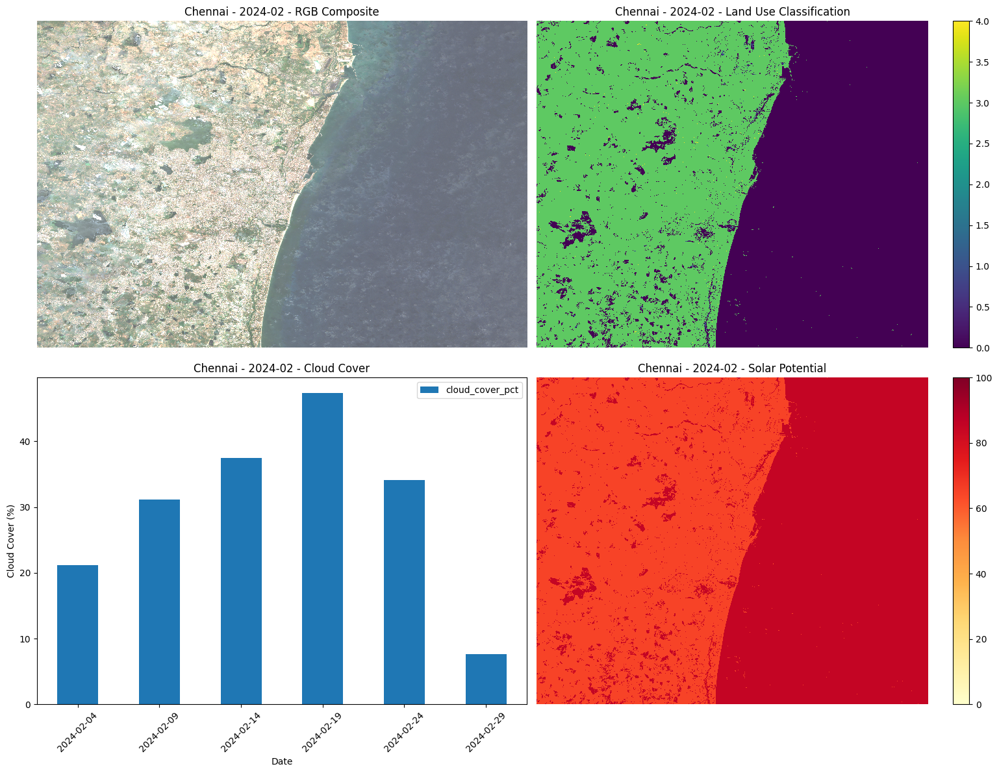

INFO:distributed.core:Event loop was unresponsive in Nanny for 12.38s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 12.39s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.38s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.39s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.39s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause ti

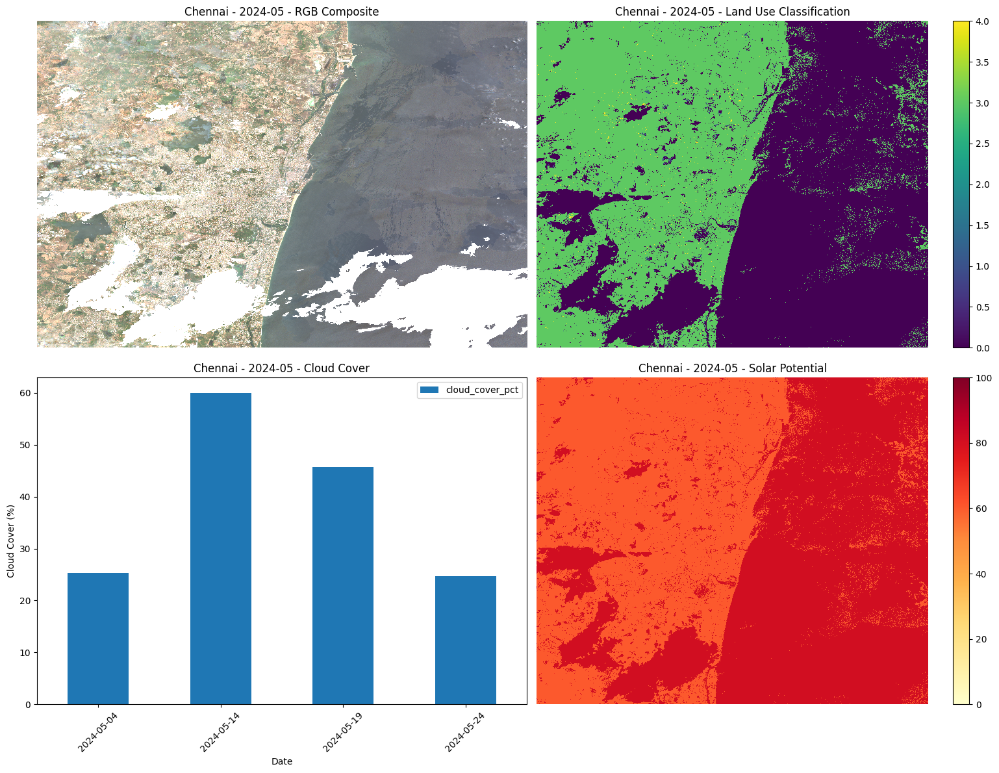

INFO:distributed.core:Event loop was unresponsive in Nanny for 12.41s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 12.42s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.41s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.42s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.42s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause ti

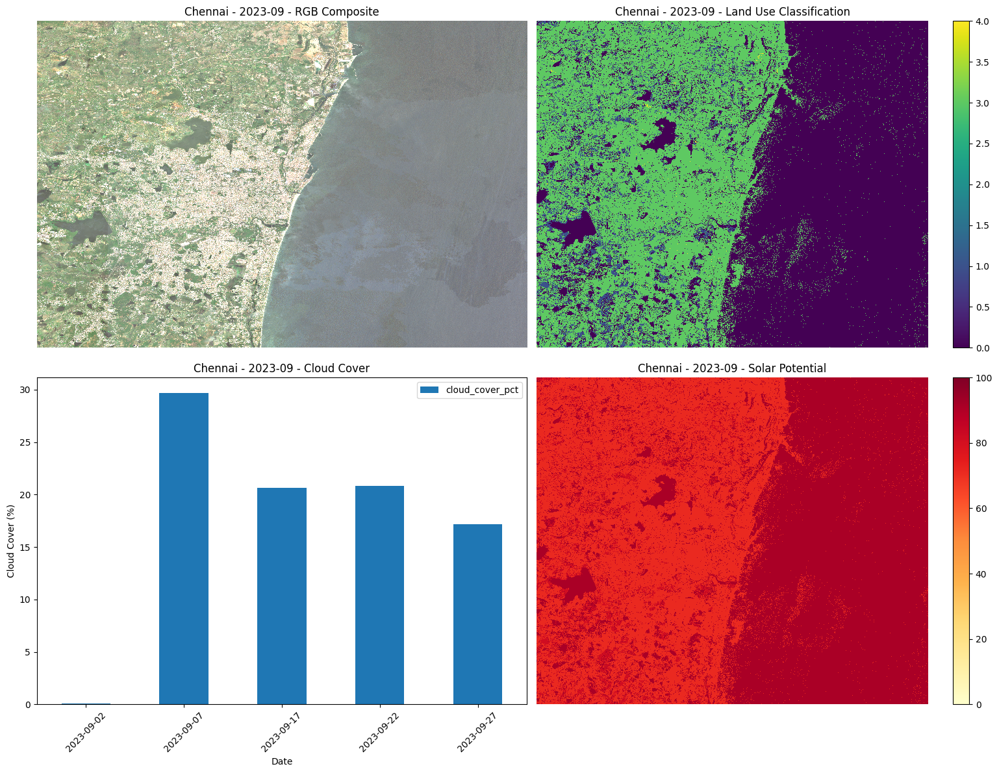

INFO:distributed.core:Event loop was unresponsive in Nanny for 12.37s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.37s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.37s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.37s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.38s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeou

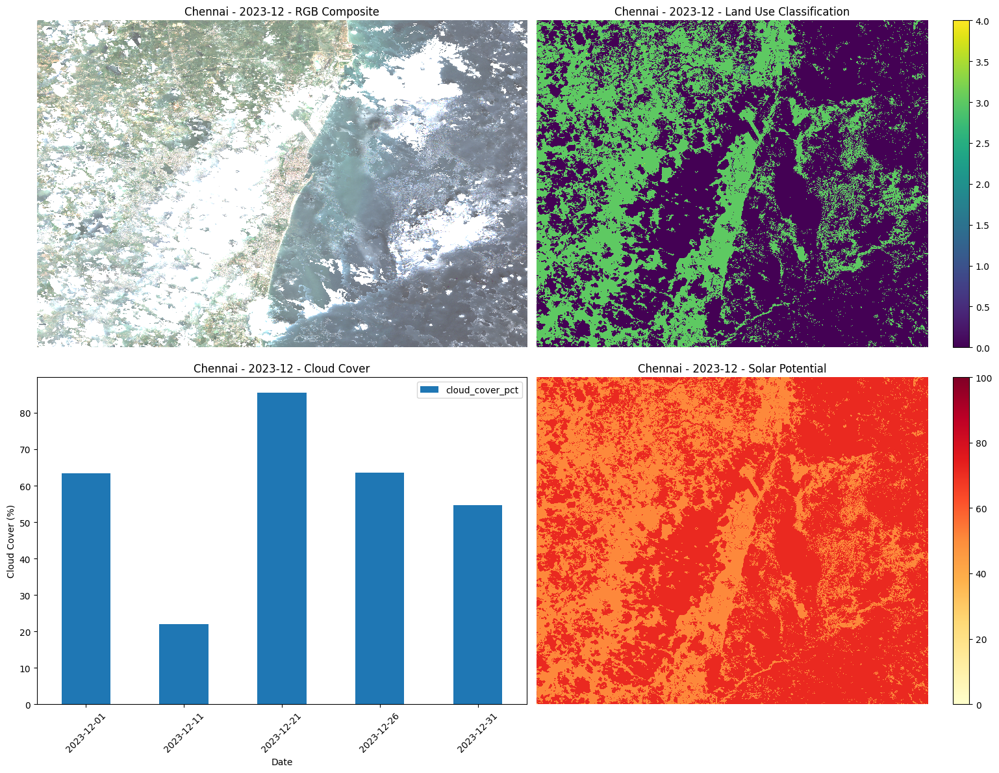

INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

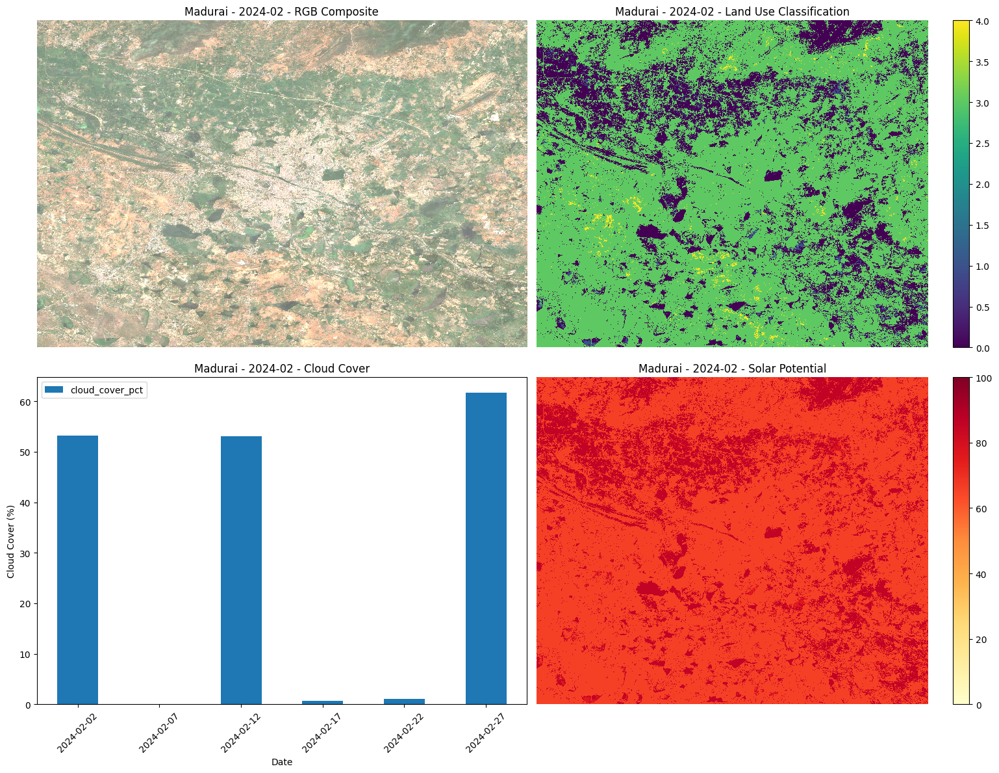

INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.73s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.73s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause tim

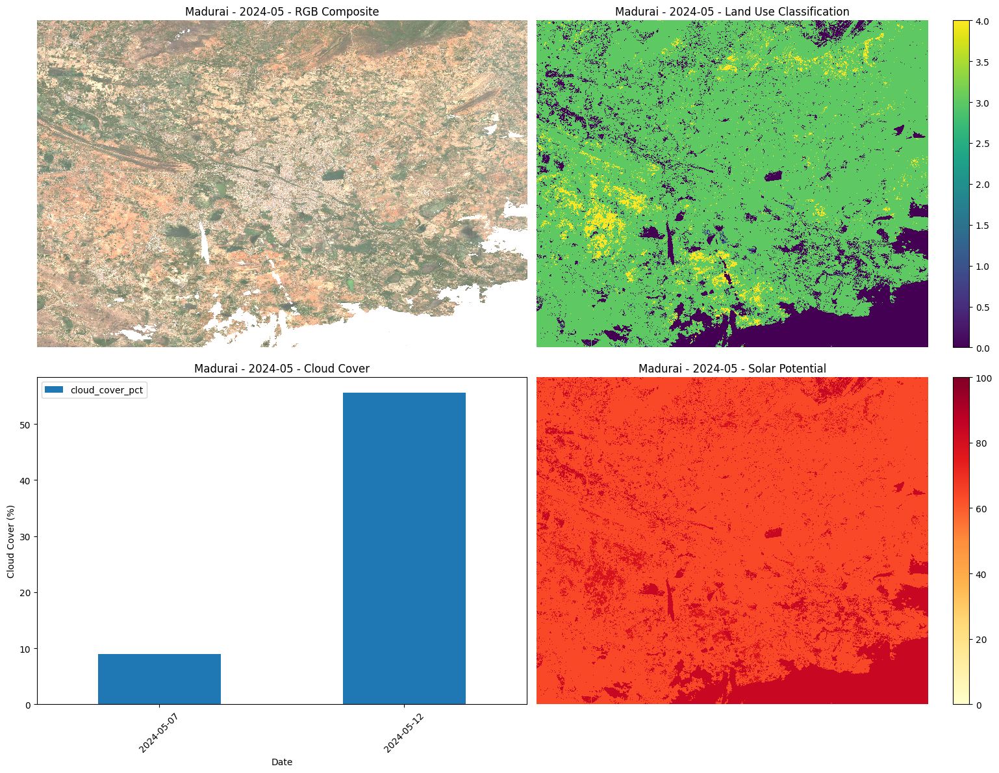

INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

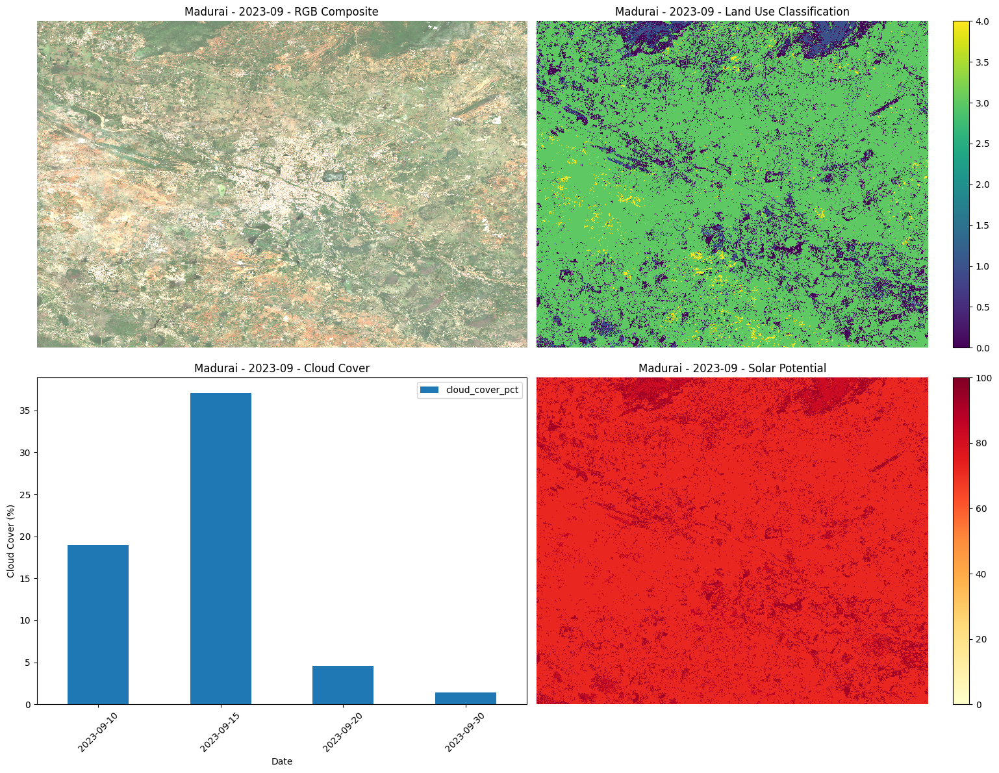

INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.68s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.68s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.69s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.69s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.68s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

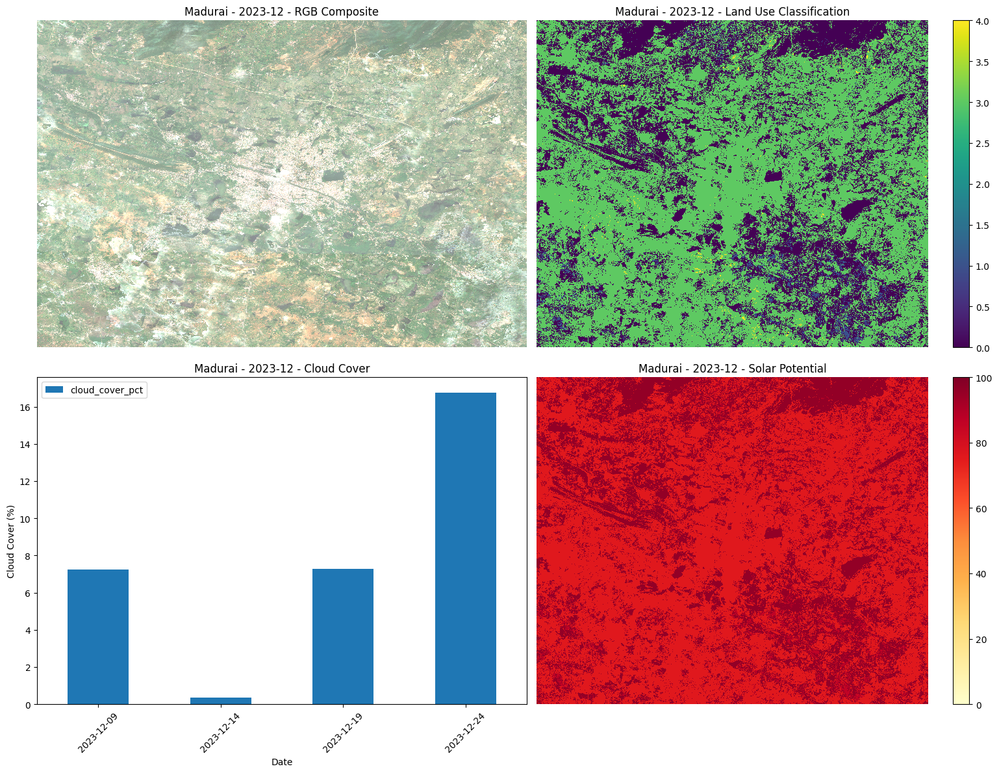

INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.22s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.22s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.27s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.25s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause tim

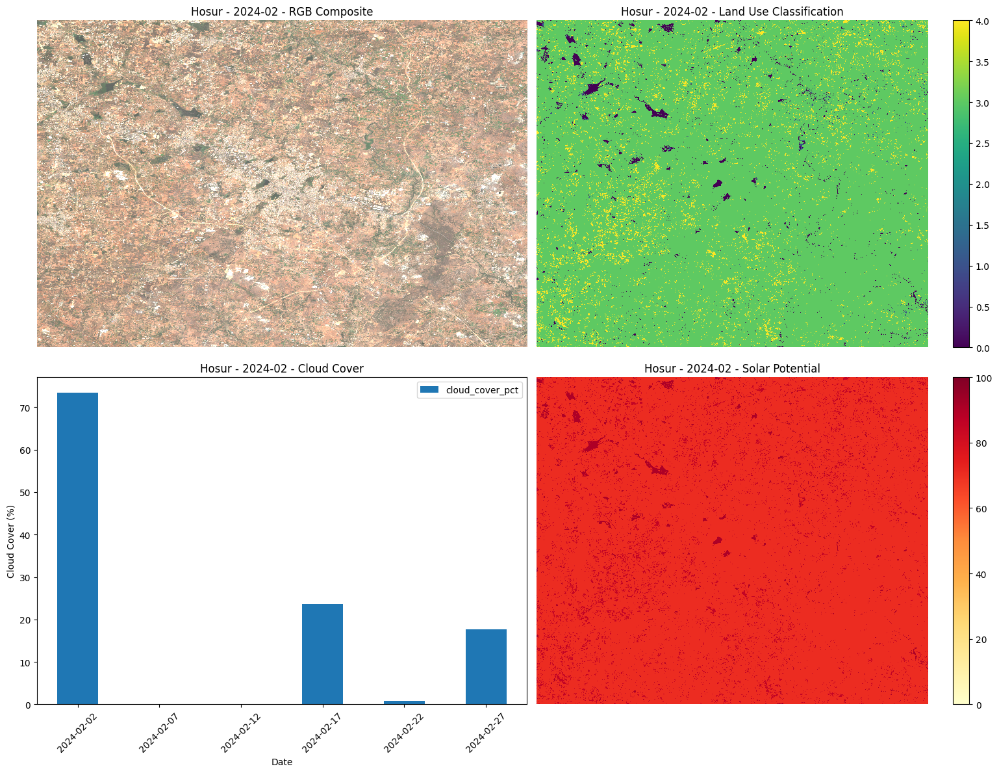

INFO:distributed.core:Event loop was unresponsive in Nanny for 3.27s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.28s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.27s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.28s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.28s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

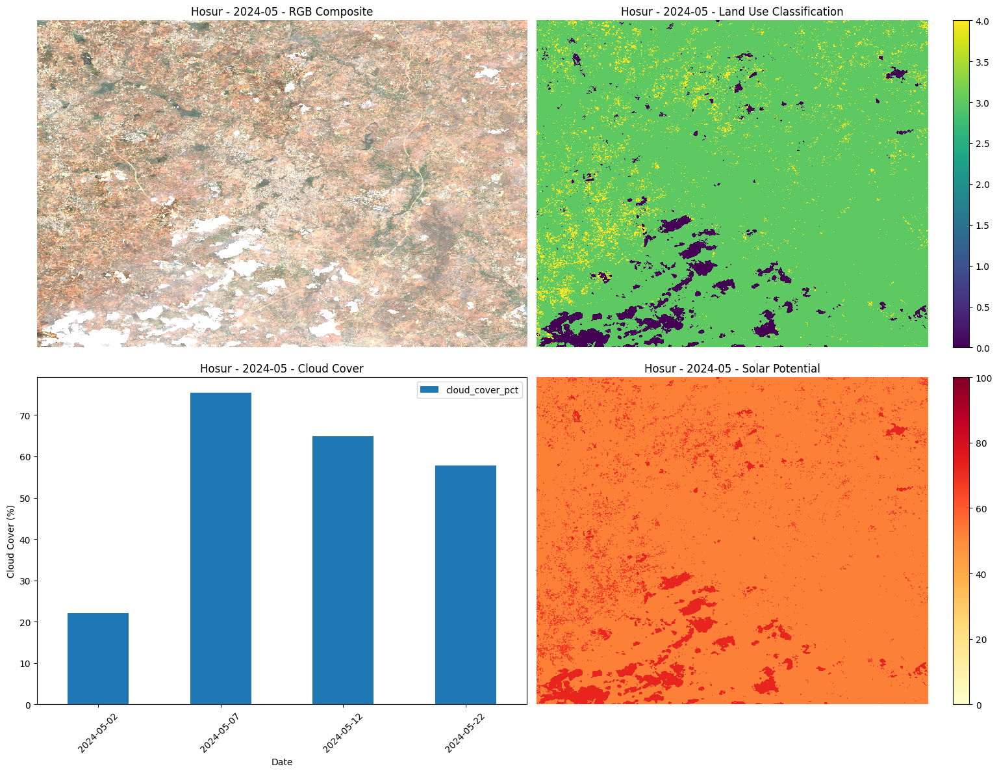

INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

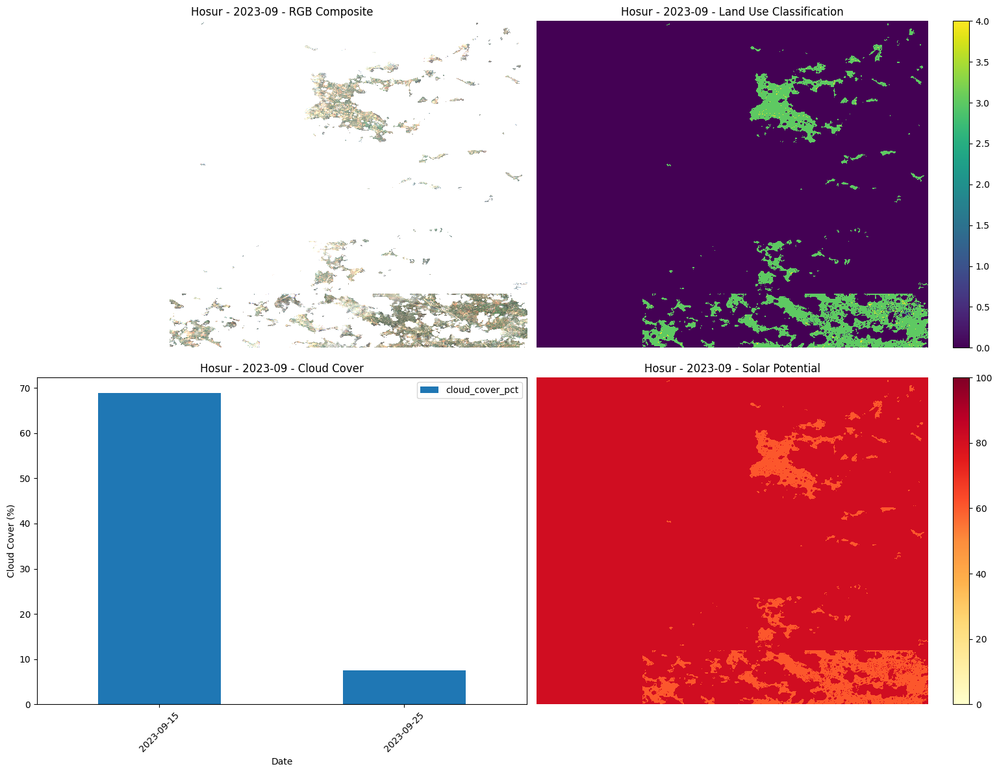

INFO:distributed.core:Event loop was unresponsive in Nanny for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

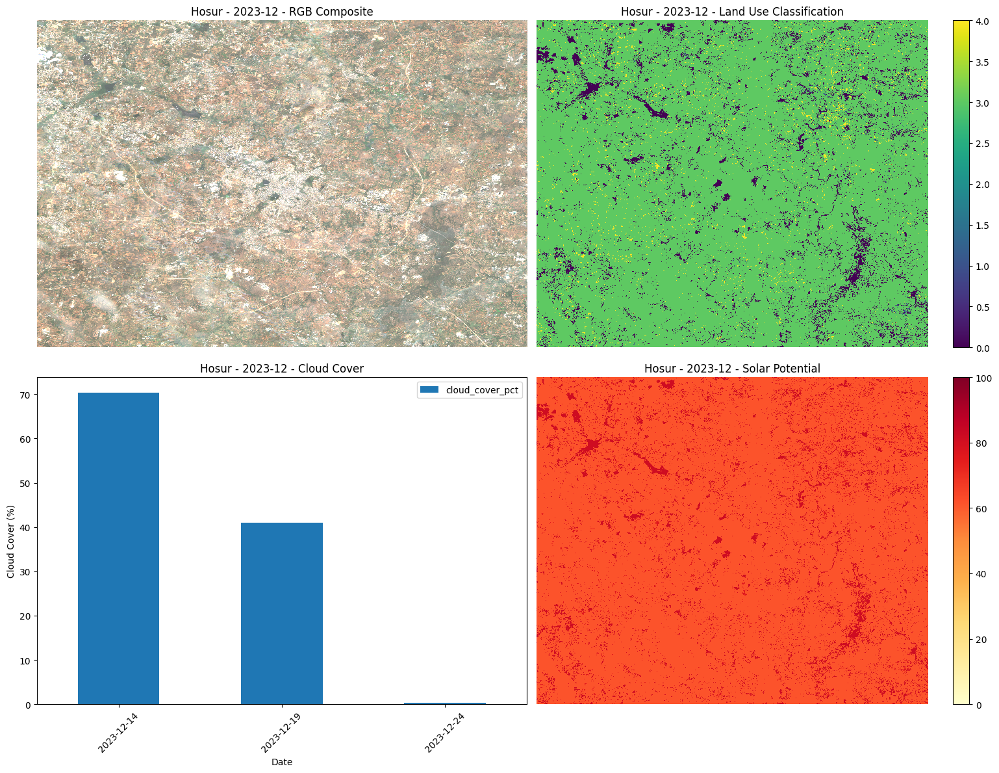

INFO:distributed.core:Event loop was unresponsive in Nanny for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

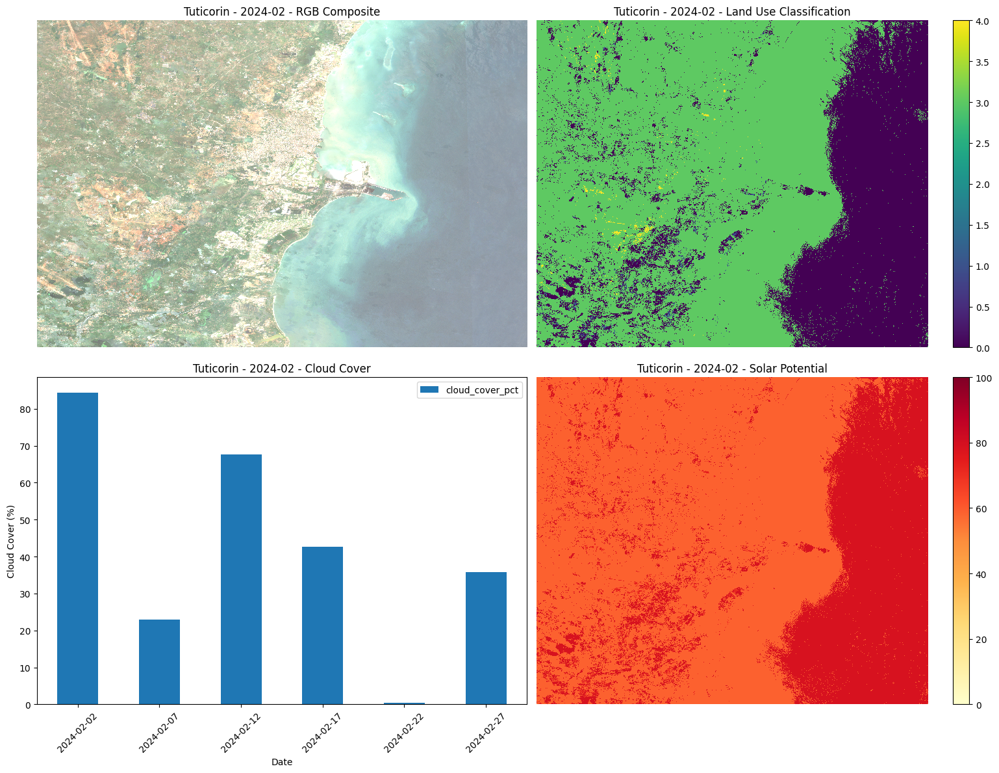

INFO:distributed.core:Event loop was unresponsive in Nanny for 5.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.78s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

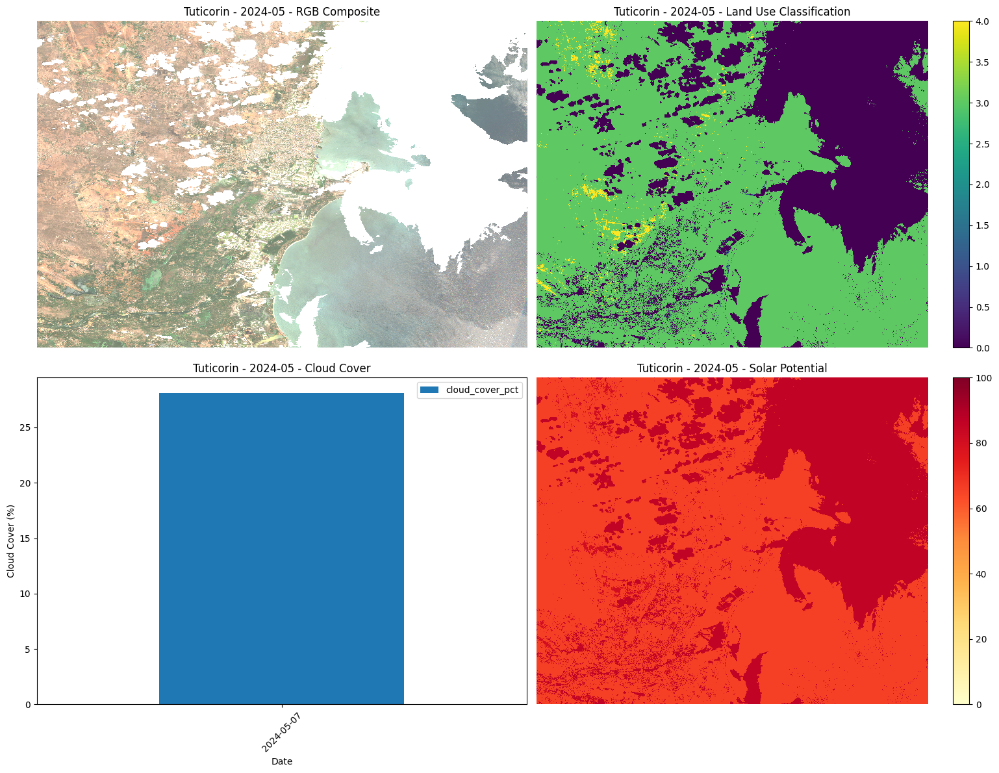

INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.73s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.73s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.73s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.73s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

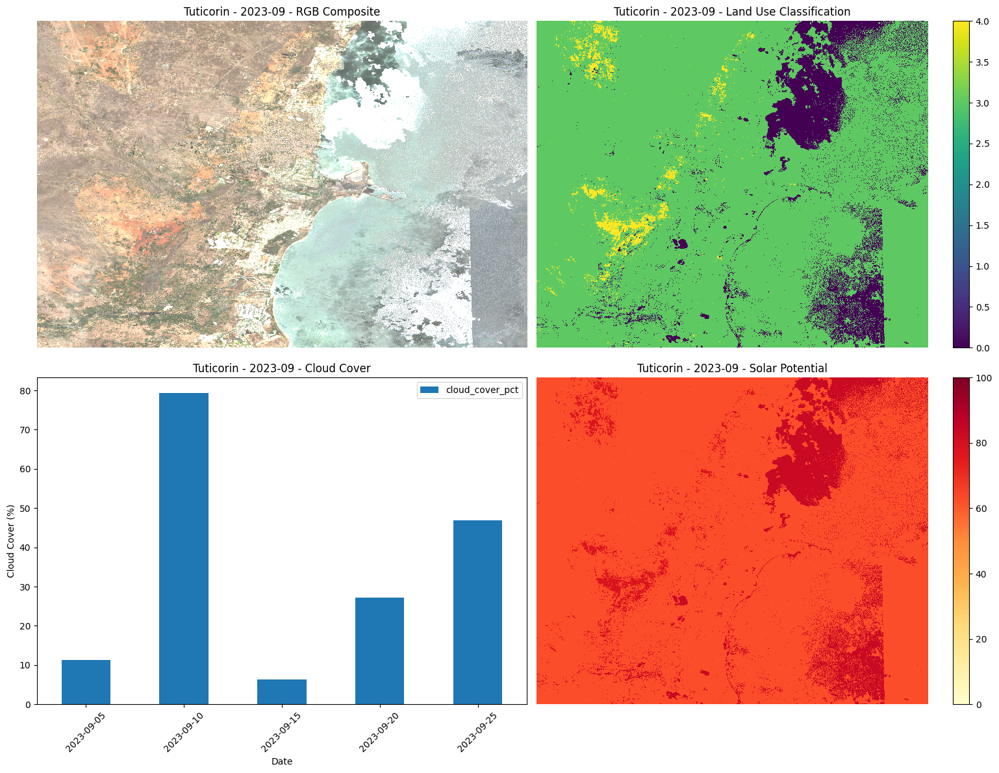

INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

KeyboardInterrupt: 

In [22]:
for city in city_results.keys():
    for period in time_periods:
        if period in city_results[city]['time_periods']:
            visualize_results(city_results, city, period)

# Function to compare seasonal variations in solar potential

In [ ]:
def compare_seasonal_solar_potential(results, city_name):
    """
    Compare seasonal variations in solar potential for a city

    Parameters:
    -----------
    results : dict
        Results dictionary
    city_name : str
        Name of the city
    """
    # Create figure
    fig, axs = plt.subplots(2, 2, figsize=(16, 12))

    # Seasons and corresponding time periods
    seasons = {
        'Winter': '2024-02',
        'Summer': '2024-05',
        'Monsoon': '2023-09',
        'Post-monsoon': '2023-12'
    }

    for i, (season, period) in enumerate(seasons.items()):
        if period not in results[city_name]['time_periods']:
            axs[i//2, i%2].text(0.5, 0.5, f"No data for {season}", ha='center', va='center')
            axs[i//2, i%2].set_title(f"{season}")
            continue

        solar = results[city_name]['time_periods'][period]['solar_potential']
        solar.plot(ax=axs[i//2, i%2], cmap='YlOrRd', vmin=0, vmax=100)
        axs[i//2, i%2].set_title(f"{season} ({period})")
        axs[i//2, i%2].axis('off')

    plt.suptitle(f"Seasonal Solar Potential for {city_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.savefig(os.path.join(output_folder, f"{city_name.lower()}_seasonal_solar_potential.png"))
    plt.show()

# Compare seasonal solar potential for each city


INFO:distributed.core:Event loop was unresponsive in Nanny for 12.49s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.49s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 12.49s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.49s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.49s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause ti

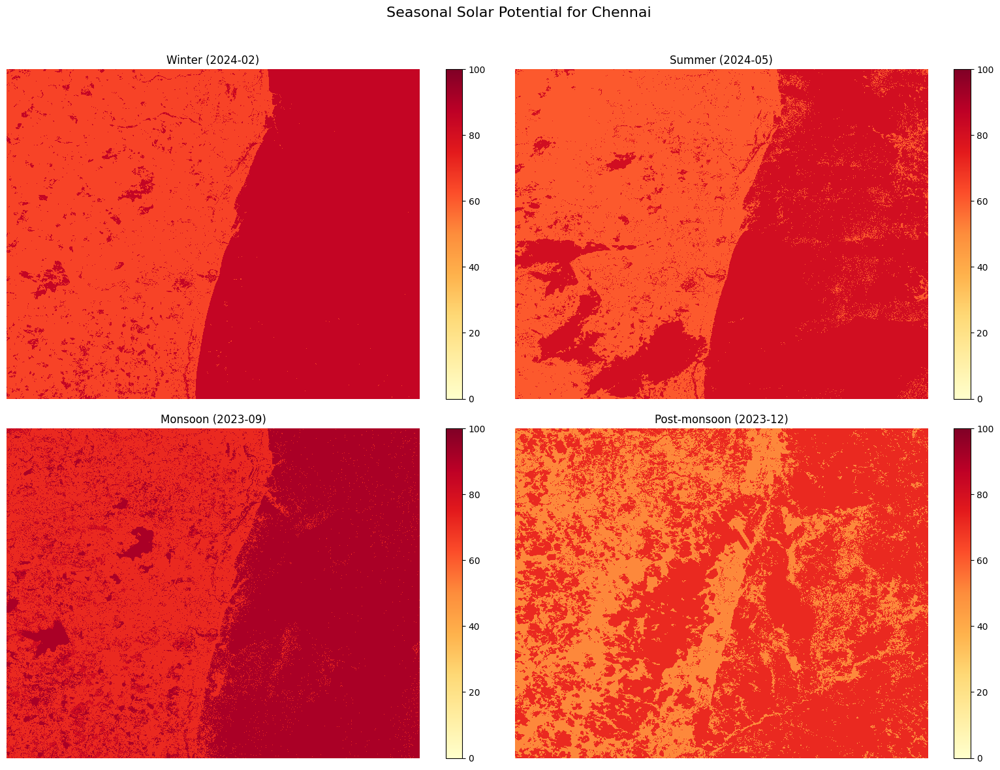

INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.83s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.83s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.83s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.83s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.83s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

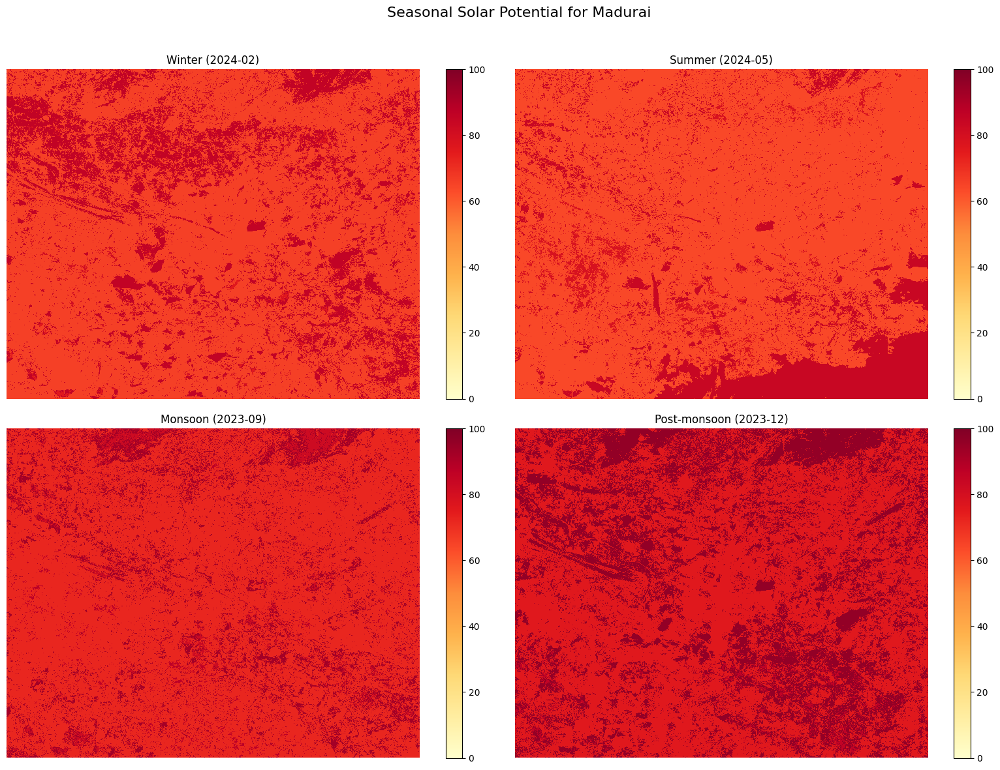

INFO:distributed.core:Event loop was unresponsive in Nanny for 3.25s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.26s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.25s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause tim

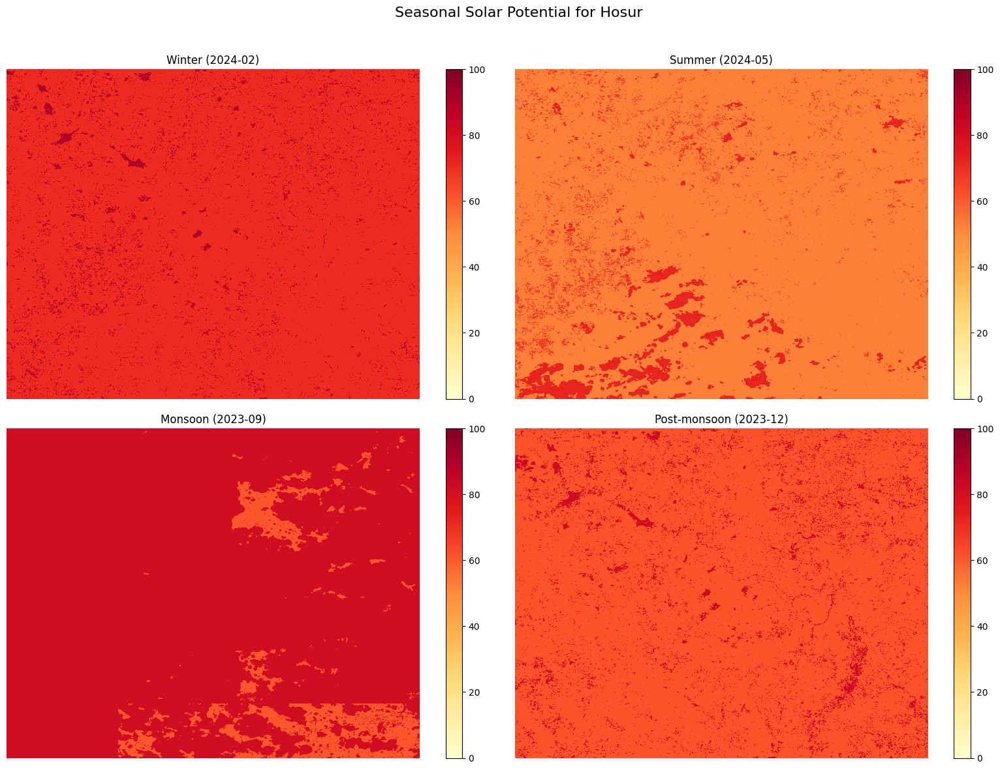

INFO:distributed.core:Event loop was unresponsive in Nanny for 5.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.82s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.82s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause

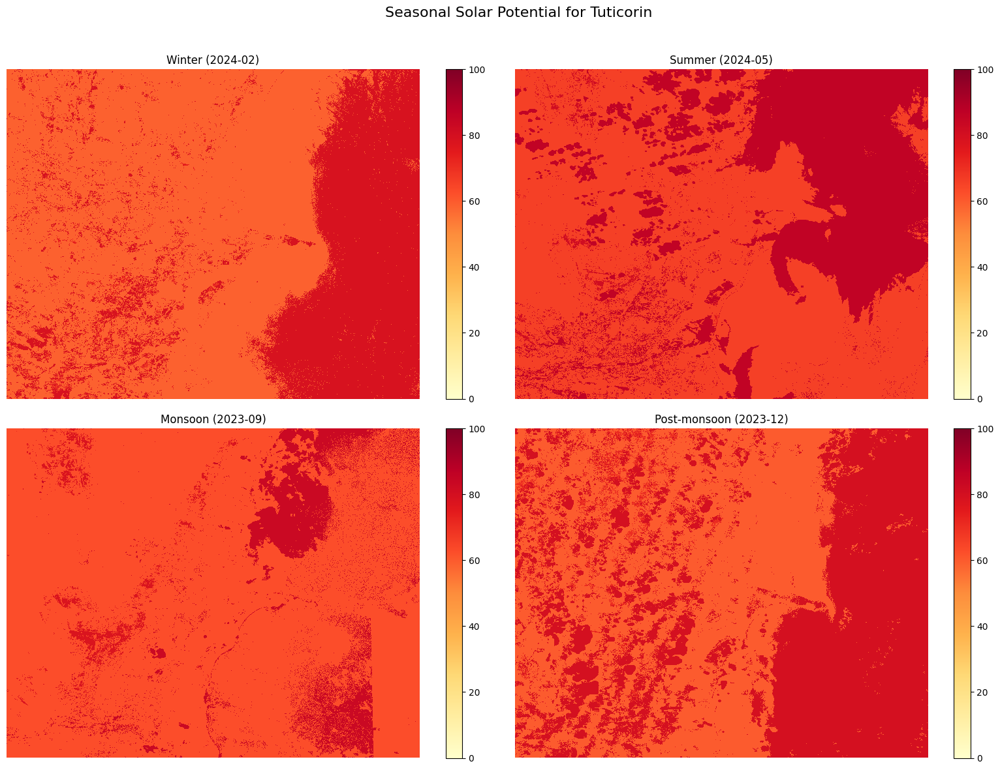

In [ ]:
# Compare seasonal solar potential for each city
for city in city_results.keys():
    compare_seasonal_solar_potential(city_results, city)

# temporal changes in land use

In [ ]:
def calculate_land_use_change(results, city_name, period1, period2):
    """
    Calculate and visualize land use change between two time periods

    Parameters:
    -----------
    results : dict
        Results dictionary
    city_name : str
        Name of the city
    period1 : str
        First time period
    period2 : str
        Second time period
    """
    if period1 not in results[city_name]['time_periods'] or period2 not in results[city_name]['time_periods']:
        print(f"One or both periods not available for {city_name}")
        return

    # Get land use classifications
    land_use1 = results[city_name]['time_periods'][period1]['land_use']
    land_use2 = results[city_name]['time_periods'][period2]['land_use']

    # Calculate change (simplified approach)
    change = land_use2 - land_use1

    # Create figure
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    # Plot first period
    land_use1.plot(ax=axs[0], cmap='viridis')
    axs[0].set_title(f"{city_name} Land Use - {period1}")
    axs[0].axis('off')

    # Plot second period
    land_use2.plot(ax=axs[1], cmap='viridis')
    axs[1].set_title(f"{city_name} Land Use - {period2}")
    axs[1].axis('off')

    # Plot change
    change.plot(ax=axs[2], cmap='RdBu', center=0)
    axs[2].set_title(f"{city_name} Land Use Change\n{period1} to {period2}")
    axs[2].axis('off')

    plt.tight_layout()
    plt.savefig(os.path.join(output_folder, f"{city_name.lower()}_land_use_change_{period1.replace('-', '_')}_{period2.replace('-', '_')}.png"))
    plt.show()

    # Calculate statistics
    change_pixels = (change != 0).sum().values.item()
    total_pixels = land_use1.count().values.item()
    change_percent = (change_pixels / total_pixels) * 100

    print(f"Land use change statistics for {city_name} between {period1} and {period2}:")
    print(f"Changed pixels: {change_pixels} ({change_percent:.2f}% of total)")

    return change

# Calculate land use change for each city (winter to summer)

INFO:distributed.core:Event loop was unresponsive in Nanny for 12.47s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.48s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 12.47s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.47s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 12.47s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause ti

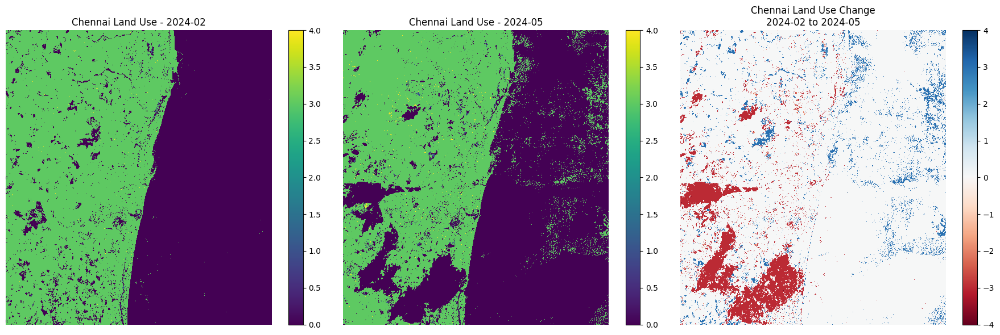

Land use change statistics for Chennai between 2024-02 and 2024-05:
Changed pixels: 4663714 (13.23% of total)


INFO:distributed.core:Event loop was unresponsive in Nanny for 5.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.76s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.76s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause tim

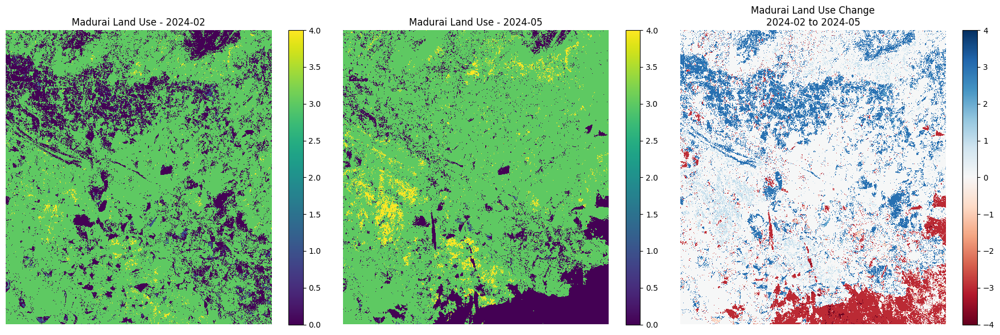

Land use change statistics for Madurai between 2024-02 and 2024-05:
Changed pixels: 4725992 (29.37% of total)


INFO:distributed.core:Event loop was unresponsive in Nanny for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.24s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause tim

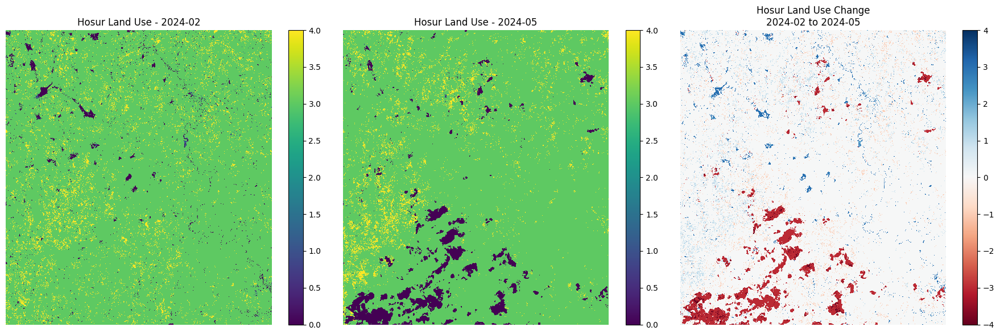

Land use change statistics for Hosur between 2024-02 and 2024-05:
Changed pixels: 1059987 (11.79% of total)


INFO:distributed.core:Event loop was unresponsive in Nanny for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.71s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.72s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause

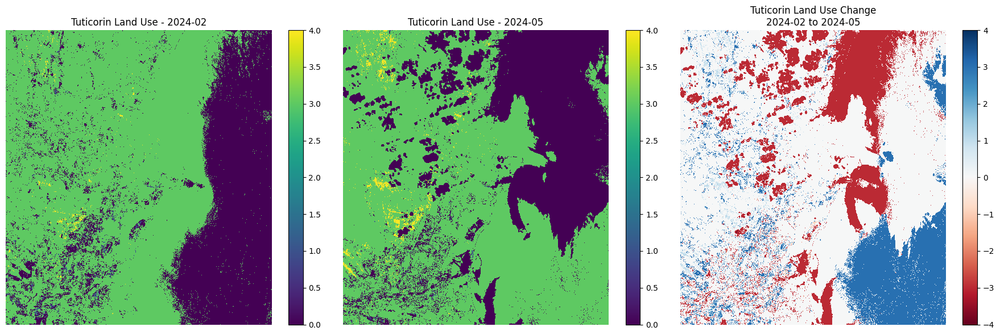

Land use change statistics for Tuticorin between 2024-02 and 2024-05:
Changed pixels: 5514005 (34.23% of total)


In [ ]:
for city in city_results.keys():
    if '2024-02' in city_results[city]['time_periods'] and '2024-05' in city_results[city]['time_periods']:
        change = calculate_land_use_change(city_results, city, '2024-02', '2024-05')

# Function to analyze drought conditions using NDVI

In [35]:
def analyze_drought(results, city_name, reference_period, analysis_period):
    """
    Analyze drought conditions using NDVI
    """
    if reference_period not in results[city_name]['time_periods'] or analysis_period not in results[city_name]['time_periods']:
        print(f"One or both periods not available for {city_name}")
        return

    # Get composites
    composite_ref = results[city_name]['time_periods'][reference_period]['composite']
    composite_analysis = results[city_name]['time_periods'][analysis_period]['composite']

    # Identify available bands
    ref_bands = composite_ref.band.values
    analysis_bands = composite_analysis.band.values

    print(f"Available bands in reference period: {ref_bands}")
    print(f"Available bands in analysis period: {analysis_bands}")

    # Find appropriate red and NIR band names
    def find_band(bands, options):
        for option in options:
            if option in bands:
                return option
        return None

    # Define potential band names
    red_options = ['red', 'B04', 'B4']
    nir_options = ['nir', 'B08', 'B8', 'B8A']

    # Find the right band names
    ref_red = find_band(ref_bands, red_options)
    ref_nir = find_band(ref_bands, nir_options)
    analysis_red = find_band(analysis_bands, red_options)
    analysis_nir = find_band(analysis_bands, nir_options)

    # Check if we found the bands
    if not all([ref_red, ref_nir, analysis_red, analysis_nir]):
        missing = []
        if not ref_red: missing.append("red band in reference period")
        if not ref_nir: missing.append("NIR band in reference period")
        if not analysis_red: missing.append("red band in analysis period")
        if not analysis_nir: missing.append("NIR band in analysis period")

        print(f"Cannot calculate NDVI: Missing {', '.join(missing)}")
        return None

    print(f"Using bands: RED={ref_red}/{analysis_red}, NIR={ref_nir}/{analysis_nir}")

    # Calculate NDVI for both periods
    ndvi_ref = calculate_ndvi(
        composite_ref.sel(band=ref_red),
        composite_ref.sel(band=ref_nir)
    )

    ndvi_analysis = calculate_ndvi(
        composite_analysis.sel(band=analysis_red),
        composite_analysis.sel(band=analysis_nir)
    )

    # Continue with the rest of your function...
    # Calculate NDVI anomaly
    ndvi_anomaly = ndvi_analysis - ndvi_ref

    # Create figure
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    # Plot reference NDVI
    ndvi_ref.plot(ax=axs[0], cmap='YlGn', vmin=0, vmax=1)
    axs[0].set_title(f"{city_name} NDVI - {reference_period}")
    axs[0].axis('off')

    # Plot analysis NDVI
    ndvi_analysis.plot(ax=axs[1], cmap='YlGn', vmin=0, vmax=1)
    axs[1].set_title(f"{city_name} NDVI - {analysis_period}")
    axs[1].axis('off')

    # Plot NDVI anomaly
    ndvi_anomaly.plot(ax=axs[2], cmap='RdYlGn', center=0, vmin=-0.5, vmax=0.5)
    axs[2].set_title(f"{city_name} NDVI Anomaly\n{reference_period} to {analysis_period}")
    axs[2].axis('off')

    plt.tight_layout()
    plt.savefig(os.path.join(output_folder, f"{city_name.lower()}_drought_analysis_{reference_period.replace('-', '_')}_{analysis_period.replace('-', '_')}.png"))
    plt.show()

    # Calculate drought statistics - with error handling
    try:
        # Negative anomaly indicates potential drought
        drought_pixels = (ndvi_anomaly < -0.1).sum().values.item()
        total_pixels = ndvi_ref.count().values.item()
        drought_percent = (drought_pixels / total_pixels) * 100

        print(f"Drought analysis for {city_name} comparing {reference_period} to {analysis_period}:")
        print(f"Potential drought areas: {drought_pixels} pixels ({drought_percent:.2f}% of total)")
    except Exception as e:
        print(f"Error calculating drought statistics: {e}")

    return ndvi_anomaly

In [36]:
for city in city_results.keys():
    if '2023-09' in city_results[city]['time_periods'] and '2024-02' in city_results[city]['time_periods']:
        ndvi_anomaly = analyze_drought(city_results, city, '2023-09', '2024-02')

Available bands in reference period: ['red' 'green' 'blue']
Available bands in analysis period: ['red' 'green' 'blue']
Cannot calculate NDVI: Missing NIR band in reference period, NIR band in analysis period
Available bands in reference period: ['red' 'green' 'blue']
Available bands in analysis period: ['red' 'green' 'blue']
Cannot calculate NDVI: Missing NIR band in reference period, NIR band in analysis period
Available bands in reference period: ['red' 'green' 'blue']
Available bands in analysis period: ['red' 'green' 'blue']
Cannot calculate NDVI: Missing NIR band in reference period, NIR band in analysis period
Available bands in reference period: ['red' 'green' 'blue']
Available bands in analysis period: ['red' 'green' 'blue']
Cannot calculate NDVI: Missing NIR band in reference period, NIR band in analysis period


# Function to integrate with Random Forest solar model

In [ ]:
def integrate_with_rf_model(city_name, solar_potential, cloud_cover_data):
    """
    Integrate remote sensing data with Random Forest solar model

    Parameters:
    -----------
    city_name : str
        Name of the city
    solar_potential : xarray.DataArray
        Solar potential from remote sensing analysis
    cloud_cover_data : pandas.DataFrame
        Cloud cover data from remote sensing analysis

    Returns:
    --------
    refined_solar_potential : xarray.DataArray
        Refined solar potential map
    """
    from sklearn.ensemble import RandomForestRegressor

    # Create synthetic training data (in a real scenario, this would come from ground measurements)
    np.random.seed(42)
    n_samples = 1000

    # Feature data: cloud cover and location
    X_train = np.column_stack([
        np.random.uniform(0, 100, n_samples),  # Cloud cover percentage
        np.random.normal(0, 1, n_samples),     # Normalized x position
        np.random.normal(0, 1, n_samples)      # Normalized y position
    ])

    # Target: actual solar output (synthetic)
    y_train = 100 - 0.7 * X_train[:, 0] + 5 * X_train[:, 1] - 3 * X_train[:, 2] + np.random.normal(0, 5, n_samples)
    y_train = np.clip(y_train, 0, 100)

    # Train Random Forest model
    rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
    rf_model.fit(X_train, y_train)

    # Create feature array for prediction
    # Extract average cloud cover
    avg_cloud_cover = cloud_cover_data['cloud_cover_pct'].mean()

    # Create normalized position grid
    y_size, x_size = solar_potential.shape
    x_grid, y_grid = np.meshgrid(
        np.linspace(-1, 1, x_size),
        np.linspace(-1, 1, y_size)
    )

    # Flatten and stack features
    features = np.column_stack([
        np.full(x_size * y_size, avg_cloud_cover),
        x_grid.flatten(),
        y_grid.flatten()
    ])

    # Make predictions
    predictions = rf_model.predict(features)

    # Reshape predictions to grid
    predicted_solar = predictions.reshape(y_size, x_size)

    # Convert to xarray with same coordinates as solar_potential
    predicted_solar_xr = xr.DataArray(
        predicted_solar,
        dims=solar_potential.dims,
        coords=solar_potential.coords
    )

    # Combine remote sensing solar potential with RF model predictions
    # Use a weighted average (60% remote sensing, 40% RF model)
    refined_solar_potential = 0.6 * solar_potential + 0.4 * predicted_solar_xr

    # Ensure values are within range [0, 100]
    refined_solar_potential = refined_solar_potential.clip(0, 100)

    # Create figure to visualize original vs. refined
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    # Plot original remote sensing solar potential
    solar_potential.plot(ax=axs[0], cmap='YlOrRd', vmin=0, vmax=100)
    axs[0].set_title(f"{city_name} - Remote Sensing Solar Potential")
    axs[0].axis('off')

    # Plot RF model prediction
    predicted_solar_xr.plot(ax=axs[1], cmap='YlOrRd', vmin=0, vmax=100)
    axs[1].set_title(f"{city_name} - RF Model Solar Potential")
    axs[1].axis('off')

    # Plot refined solar potential
    refined_solar_potential.plot(ax=axs[2], cmap='YlOrRd', vmin=0, vmax=100)
    axs[2].set_title(f"{city_name} - Refined Solar Potential")
    axs[2].axis('off')

    plt.tight_layout()
    plt.savefig(os.path.join(output_folder, f"{city_name.lower()}_refined_solar_potential.png"))
    plt.show()

    return refined_solar_potential

# Integrate with RF model for each city (using summer data)

In [ ]:
for city in city_results.keys():
    if '2024-04' in city_results[city]['time_periods']:
        solar_potential = city_results[city]['time_periods']['2024-04']['solar_potential']
        cloud_cover = city_results[city]['time_periods']['2024-04']['cloud_cover']

        refined_potential = integrate_with_rf_model(city, solar_potential, cloud_cover)

        # Add to results
        city_results[city]['time_periods']['2024-04']['refined_solar_potential'] = refined_potential

# Function to create an interactive map of solar potential
def create_interactive_map(results, city_name, time_period):
    """
    Create an interactive map of solar potential for a city

    Parameters:
    -----------
    results : dict
        Results dictionary
    city_name : str
        Name of the city
    time_period : str
        Time period to visualize
    """
    if time_period not in results[city_name]['time_periods']:
        print(f"No results available for {city_name} in {time_period}")
        return

    # Get city geometry
    city_gdf = city_gdfs[city_name]

    # Get solar potential
    if 'refined_solar_potential' in results[city_name]['time_periods'][time_period]:
        solar = results[city_name]['time_periods'][time_period]['refined_solar_potential']
    else:
        solar = results[city_name]['time_periods'][time_period]['solar_potential']

    # Convert to GeoTIFF for mapping
    solar_file = os.path.join(output_folder, f"{city_name.lower()}_{time_period.replace('-', '_')}_solar_for_map.tif")
    solar.rio.to_raster(solar_file)

    # Create map
    center_lat = tamilnadu_cities[city_name]['lat']
    center_lon = tamilnadu_cities[city_name]['lon']

    # Initialize map
    m = geemap.Map(center=[center_lat, center_lon], zoom=11)

    # Add city boundary
    m.add_geojson(city_files[city_name], layer_name=f"{city_name} Boundary")

    # Add solar potential raster
    m.add_raster(solar_file, colormap='RdYlGn', layer_name=f"Solar Potential {time_period}")

    # Add a legend
    legend_colors = ['#d73027', '#fc8d59', '#fee08b', '#d9ef8b', '#91cf60', '#1a9850']
    legend_labels = ['0-20%', '20-40%', '40-60%', '60-80%', '80-100%']
    m.add_legend(title=f"{city_name} Solar Potential", colors=legend_colors, labels=legend_labels)

    return m

# Create interactive maps for each city (summer period)
for city in city_results.keys():
    if '2024-04' in city_results[city]['time_periods']:
        solar_map = create_interactive_map(city_results, city, '2024-04')
        solar_map.to_html(os.path.join(output_folder, f"{city_name.lower()}_solar_map.html"))
        display(solar_map)


# Generate final summary report

In [ ]:
def generate_summary_report(results):
    """
    Generate a summary report of the analysis
    """
    report = []
    report.append("# Tamil Nadu Remote Sensing Solar Potential Analysis")
    report.append("\n## Summary of Analysis")

    # Overall statistics
    report.append("\n### Cities Analyzed")
    for city in results.keys():
        periods = list(results[city]['time_periods'].keys())
        report.append(f"- **{city}**: {len(periods)} time periods analyzed ({', '.join(periods)})")

    # Seasonal analysis
    report.append("\n### Seasonal Solar Potential")
    seasons = {
        'Winter': '2024-01',
        'Summer': '2024-04',
        'Monsoon': '2023-08',
        'Post-monsoon': '2023-11'
    }

    for city in results.keys():
        report.append(f"\n#### {city}")

        for season, period in seasons.items():
            if period in results[city]['time_periods']:
                solar = results[city]['time_periods'][period]['solar_potential']
                avg_potential = float(solar.mean().values)
                report.append(f"- **{season}**: Average Solar Potential = {avg_potential:.2f}%")

    # Land use statistics
    report.append("\n### Land Use Statistics")
    for city in results.keys():
        report.append(f"\n#### {city}")

        if '2024-04' in results[city]['time_periods']:  # Use summer for current stats
            land_use = results[city]['time_periods']['2024-04']['land_use']

            # Count pixels for each land use class
            total_pixels = float(land_use.count().values)
            if total_pixels > 0:
                veg_pixels = float(((land_use == 1).sum() / total_pixels * 100).values)
                water_pixels = float(((land_use == 2).sum() / total_pixels * 100).values)
                built_pixels = float(((land_use == 3).sum() / total_pixels * 100).values)
                bare_pixels = float(((land_use == 4).sum() / total_pixels * 100).values)
                other_pixels = float(((land_use == 0).sum() / total_pixels * 100).values)

                report.append(f"- Vegetation: {veg_pixels:.2f}%")
                report.append(f"- Water: {water_pixels:.2f}%")
                report.append(f"- Built-up: {built_pixels:.2f}%")
                report.append(f"- Bare Soil: {bare_pixels:.2f}%")
                report.append(f"- Other: {other_pixels:.2f}%")

    # Cloud cover statistics
    report.append("\n### Cloud Cover Statistics")
    for city in results.keys():
        report.append(f"\n#### {city}")

        seasonal_cloud = {}
        for season, period in seasons.items():
            if period in results[city]['time_periods']:
                cloud_df = results[city]['time_periods'][period]['cloud_cover']
                avg_cloud = cloud_df['cloud_cover_pct'].mean()
                seasonal_cloud[season] = avg_cloud
                report.append(f"- **{season}**: Average Cloud Cover = {avg_cloud:.2f}%")

        # If we have data for all seasons, identify best season
        if len(seasonal_cloud) >= 2:
            best_season = min(seasonal_cloud, key=seasonal_cloud.get)
            report.append(f"- **Best season for solar energy**: {best_season} with {seasonal_cloud[best_season]:.2f}% average cloud cover")

    # Solar potential recommendations
    report.append("\n### Solar Potential Recommendations")
    for city in results.keys():
        report.append(f"\n#### {city}")

        # Check if we have refined solar potential
        if '2024-04' in results[city]['time_periods'] and 'refined_solar_potential' in results[city]['time_periods']['2024-04']:
            solar = results[city]['time_periods']['2024-04']['refined_solar_potential']

            # Simple analysis for recommendations
            avg_potential = float(solar.mean().values)
            max_potential = float(solar.max().values)

            if avg_potential > 70:
                recommendation = "Excellent solar potential across most of the city"
            elif avg_potential > 50:
                recommendation = "Good solar potential in many areas of the city"
            elif avg_potential > 30:
                recommendation = "Moderate solar potential, consider focusing on high-potential areas"
            else:
                recommendation = "Limited solar potential, careful site selection required"

            report.append(f"- Average Solar Potential: {avg_potential:.2f}%")
            report.append(f"- Maximum Solar Potential: {max_potential:.2f}%")
            report.append(f"- Recommendation: {recommendation}")

    # Write report to file
    report_text = "\n".join(report)
    with open(os.path.join(output_folder, "tamilnadu_solar_analysis_report.md"), "w") as f:
        f.write(report_text)

    print("Summary report generated and saved to tamilnadu_solar_analysis_report.md")

    return report_text

# Generate summary report
summary_report = generate_summary_report(city_results)
print(summary_report)

Summary report generated and saved to tamilnadu_solar_analysis_report.md
# Tamil Nadu Remote Sensing Solar Potential Analysis

## Summary of Analysis

### Cities Analyzed
- **Chennai**: 4 time periods analyzed (2024-02, 2024-05, 2023-09, 2023-12)
- **Madurai**: 4 time periods analyzed (2024-02, 2024-05, 2023-09, 2023-12)
- **Hosur**: 4 time periods analyzed (2024-02, 2024-05, 2023-09, 2023-12)
- **Tuticorin**: 4 time periods analyzed (2024-02, 2024-05, 2023-09, 2023-12)

### Seasonal Solar Potential

#### Chennai

#### Madurai

#### Hosur

#### Tuticorin

### Land Use Statistics

#### Chennai

#### Madurai

#### Hosur

#### Tuticorin

### Cloud Cover Statistics

#### Chennai

#### Madurai

#### Hosur

#### Tuticorin

### Solar Potential Recommendations

#### Chennai

#### Madurai

#### Hosur

#### Tuticorin


# Final Analysis

In [ ]:
print("\n=== Analysis Complete ===")
print(f"Results have been saved to the {output_folder} directory")
print("Key files generated:")
print("1. Composite images (.tif files)")
print("2. Solar potential maps (.tif files)")
print("3. Visualization images (.png files)")
print("4. Interactive solar potential maps (.html files)")
print("5. Summary report (tamilnadu_solar_analysis_report.md)")


=== Analysis Complete ===
Results have been saved to the output directory
Key files generated:
1. Composite images (.tif files)
2. Solar potential maps (.tif files)
3. Visualization images (.png files)
4. Interactive solar potential maps (.html files)
5. Summary report (tamilnadu_solar_analysis_report.md)
